# Computational Optimal Transport - MVA - Final Project


## Optimal transport mapping via input convex neural networks

* Implementation of [Optimal transport mapping via input convex neural networks](https://arxiv.org/abs/1908.10962)
* Experimental tests across different datasets and comparison with traditional methods

In [ ]:
!pip install --upgrade numpy
!pip install POT

     |████████████████████████████████| 15.7 MB 265 kB/s 
  Attempting uninstall: numpy
    Found existing installation: numpy 1.19.5
    Uninstalling numpy-1.19.5:
      Successfully uninstalled numpy-1.19.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
yellowbrick 1.3.post1 requires numpy<1.20,>=1.16.0, but you have numpy 1.21.5 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


     |████████████████████████████████| 650 kB 5.4 MB/s 


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import ot
import ot.plot
import torch
from torch.utils.data import Dataset
from torch import nn, optim

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


## Implementation of the algorithm

In [ ]:
class ICNet(nn.Module):
    def __init__(self, input_size=2, hidden_size=64, layers=4):
        super(ICNet, self).__init__()
        self.linear_layers = nn.ModuleList()
        self.convex_layers = nn.ModuleList()
        
        self.linear_layers.append(nn.Linear(input_size, hidden_size, bias=True))
        for i in range(layers-2):
            self.linear_layers.append(nn.Linear(input_size, hidden_size, bias=True))
            self.convex_layers.append(nn.Linear(hidden_size, hidden_size, bias=False))
        
        self.linear_layers.append(nn.Linear(input_size, 1, bias=True))
        self.convex_layers.append(nn.Linear(hidden_size, 1, bias=False))
        self.leaky_relu = nn.LeakyReLU(0.2)
        
        # Convexity constraint on both networks
        for convex_layer in self.convex_layers:
                    for p in convex_layer.parameters():
                        p.data.clamp_(0)
    
    def forward(self, x):
        y = self.linear_layers[0](x)
        y = self.leaky_relu(y).pow(2)
        for linear_layer, convex_layer in zip(self.linear_layers[1:-1], self.convex_layers[:-1]):
            y = linear_layer(x) + convex_layer(y)
            y = self.leaky_relu(y)
        y = (self.linear_layers[-1](x).pow(1) + self.convex_layers[-1](y))
        return self.leaky_relu(y)

In [ ]:
def generate_2_gaussians(n_samples, mean_X, var_X, mean_Y, var_Y):
    X = np.random.multivariate_normal(mean_X, np.eye(len(mean_X))*var_X, size=n_samples)
    Y = np.random.multivariate_normal(mean_Y, np.eye(len(mean_Y))*var_Y, size=n_samples)
    return X, Y

In [ ]:
def generate_triangle_of_gaussians(n_samples):
    X_samples = int(n_samples / 3)
    X_1 = np.random.multivariate_normal(np.array([-6,-1.5]), np.eye(2), size=X_samples)
    X_2 = np.random.multivariate_normal([-12, 12], np.eye(2), size=X_samples)
    X_3 = np.random.multivariate_normal([0, 12], np.eye(2), size=X_samples)
    Y = np.random.multivariate_normal([-6 , 6], np.eye(2), size=n_samples)
    X = np.vstack([X_1, X_2, X_3])
    return X,Y

In [ ]:
def generate_8_gaussians(n_samples):
    X_samples = int(n_samples / 8)
    theta = np.linspace(0, 2*np.pi, 9)[:8]
    X = np.vstack([np.random.multivariate_normal(np.array([5*np.cos(th),5*np.sin(th)]), np.eye(2)*0.5, size=X_samples) for th in theta])
    Y = np.random.multivariate_normal([0,0], np.eye(2), size=n_samples)
    return X,Y

In [ ]:
def python_OT(x,y):
    """
    Compute transport from y to x
    """
    n = x.shape[0]
    a, b = np.ones((n,)) / n, np.ones((n,)) / n

    # cost matrix
    M = ot.dist(y, x)
    scaling = M.max()
    M /= M.max()

    G0 = ot.emd(a, b, M, numItermax=10_000_000)

    return scaling*sum(sum(G0*M))*0.5, G0

In [ ]:
plotp = lambda x,col, alpha=1.0: plt.scatter(x[0,:], x[1,:], s=200, edgecolors="k", c=col, linewidths=2, alpha=alpha)

In [ ]:
def draw_arrow(A, B):
    plt.arrow(A[0], A[1], B[0] - A[0], B[1] - A[1], color=[0.5,0.5,1], alpha = .2)

def display_transports_2d(X, Y, X_to_Y, Y_to_X):
    # Only plot first 2 dimensions
    X, Y = X[:2, :], Y[:2, :]
    X_to_Y, Y_to_X = X_to_Y[:2, :], Y_to_X[:2, :]
    plt.figure(figsize=(10,5))
    plt.suptitle("Learned transport maps")

    plt.subplot(121)
    plotp(X, 'green')
    plotp(Y, 'orange')
    plotp(Y_to_X, 'red', alpha=0.4)
    # If not too many points, we plot the arrows
    if X.shape[1] < 500:
        for i in range(X.shape[1]):
            draw_arrow(Y[:, i], Y_to_X[:, i])
    plt.axis("equal")
    plt.legend(["X", "Y", f"$\\nabla g(Y)$"])

    plt.subplot(122)
    plotp(X, 'green')
    plotp(Y, 'orange')
    plotp(X_to_Y, 'skyblue', alpha=0.4)
    # If not too many points, we plot the arrows
    if X.shape[1] < 500:
        for i in range(Y.shape[1]):
            draw_arrow(X[:, i], X_to_Y[:, i])
    plt.axis("equal")
    plt.legend(["X", "Y", f"$\\nabla f(X)$"])
    plt.show()

In [ ]:
def display_distance(model):
    plt.figure()
    plt.plot(model.w2[1:])
    plt.hlines(model.exact_distance, 0, len(model.w2[1:]), colors="red")
    if model.closed_form:
        plt.hlines(model.closed_form_distance, 0, len(model.w2[1:]), colors="purple")
        plt.legend(["Approx distance", "Distance using POT solver", "Closed form distance"])
    else:
        plt.legend(["Approx distance", "Distance using POT solver"])
    plt.title(f"Approximated $W_2^2$ during training")
    plt.grid()

In [ ]:
def display_mean(model):
    plt.figure()
    plt.plot(model.mean_diffs[1:])
    plt.title("$||\mathbb{E}(X) - \mathbb{E}(\\nabla g(Y))||$")
    plt.grid()

In [ ]:
def closed_form_solution(mean_X, var_X, mean_Y, var_Y):
    mean_X = np.array(mean_X)
    mean_Y = np.array(mean_Y)
    dim = len(mean_X)
    inv_a_sqrt = np.eye(dim) * 1 / np.sqrt(var_X)
    a_sqrt = np.eye(dim) * np.sqrt(var_X)
    aux = np.sqrt(var_X) * np.sqrt(var_Y) * np.eye(dim)
    return (np.linalg.norm(mean_X - mean_Y, ord=2)**2 + np.linalg.norm(np.ones(dim) * var_X - np.ones(dim) * var_Y, ord=2)**2) / 2

In [ ]:
def closed_form_transport(X, Y, mean_X, var_X, mean_Y, var_Y):
    dim = len(mean_X)
    inv_a_sqrt = np.eye(dim) * 1 / np.sqrt(var_X)
    a_sqrt = np.eye(dim) * np.sqrt(var_X)
    aux = np.sqrt(var_X) * np.sqrt(var_Y) * np.eye(dim)
    X_to_Y = np.empty_like(X)
    for i,x in enumerate(X):
        X_to_Y[i] = mean_Y + (inv_a_sqrt@aux@inv_a_sqrt)@(x-mean_X)
    # Only plot first 2 dimensions
    X, Y = X[:, :2], Y[:, :2]
    X_to_Y = X_to_Y[:, :2]
    plt.figure(figsize=(5,5))
    plt.title("Closed form transport map")
    plotp(X.T, 'green')
    plotp(Y.T, 'orange')
    plotp(X_to_Y.T, 'skyblue', alpha=0.4)
    # If not too many points, we plot the arrows
    if X.shape[0] < 500:
        for i in range(Y.shape[0]):
            draw_arrow(X.T[:, i], X_to_Y.T[:, i])
    plt.axis("equal")
    plt.legend(["X", "Y", f"$T(X)$"])
    plt.show()

In [ ]:
class IcnnOt:
    def __init__(self, dim, hidden_size, layers, closed_form=False, continuous=False):
        self.dim = dim
        self.f = ICNet(dim, hidden_size, layers).to(device)
        self.g = ICNet(dim, hidden_size, layers).to(device)
        # Store evolution of w distance approximation
        self.w2 = []
        # Store evolution of norm of the difference of the means between distributions
        self.mean_diffs = []

        # Flag indicating if exists a closed form solution
        self.closed_form = closed_form

        # Flag indicating the kind of problem (cont-cont or disc-disc)
        self.continuous = continuous

    def train(self, t_iters, k_iters, eval_freq, eval_plot, dataset_generator, dataset_parameters):
        # Dataset parametrization
        parameters = dataset_parameters.get("dataset")
        train_samples = dataset_parameters.get("train_samples")
        test_samples = dataset_parameters.get("val_samples")
        # Optimizer
        optimizer_f = optim.Adam(self.f.parameters(), betas=(0.5,0.9), lr=1e-4)
        optimizer_g = optim.Adam(self.g.parameters(), betas=(0.5,0.9), lr=1e-4)
        # Test data
        test_X, test_Y = dataset_generator(test_samples, **parameters)
        # Exact OT distance
        exact_distance, _ = python_OT(test_X, test_Y)
        # Save exact distance
        self.exact_distance = exact_distance
        # Closed form distance
        if self.closed_form:
            closed_form_distance = closed_form_solution(**parameters)
            # Save closed form distance
            self.closed_form_distance = closed_form_distance
        test_X = torch.tensor(test_X, requires_grad=True, dtype=torch.float32).to(device)
        test_Y = torch.tensor(test_Y, requires_grad=True, dtype=torch.float32).to(device)
        # Training loop
        for t in range(t_iters):
            # Sample batch of data (if continuous case, we keep sampling data from the continuous dist)
            if self.continuous:
                X, Y = dataset_generator(train_samples, **parameters)
                X = torch.tensor(X, dtype=torch.float32, requires_grad=True).to(device)
                Y = torch.tensor(Y, dtype=torch.float32, requires_grad=True).to(device)
            else:
                # We subsample the discrete point cloud
                X_indices = torch.randperm(len(test_X))[:train_samples]
                Y_indices = torch.randperm(len(test_Y))[:train_samples]
                X = test_X[X_indices]  
                Y = test_Y[Y_indices]  
            # Inner iterations -> update g
            for k in range(k_iters):
                g_y = self.g(Y)
                grad_gy = torch.autograd.grad(g_y, Y, torch.ones_like(g_y), create_graph=True)[0]
                f_grad_gy = self.f(grad_gy)
                # Loss in g
                loss_g = (f_grad_gy - (Y * grad_gy).sum(axis=1, keepdims=True)).mean()
                # Regularization for g (relaxing convexity constraint)
                for W in self.g.convex_layers:
                    for p in W.parameters():
                        loss_g += torch.relu(-p).pow(2).sum()
                # Flush gradient of g
                optimizer_g.zero_grad()
                loss_g.backward(retain_graph=True)
                optimizer_g.step()

            # Outer iterations -> update f
            g_y = self.g(Y)
            grad_gy = torch.autograd.grad(g_y, Y, torch.ones_like(g_y))[0]
            f_grad_gy = self.f(grad_gy)
            f_x = self.f(X)
            # Loss in f (gradient ascent)
            loss_f = - (f_grad_gy - f_x).mean()
            optimizer_f.zero_grad()
            # Flush gradient of f
            loss_f.backward()
            optimizer_f.step()
            # Convex constraint in f
            for convex_layer in self.f.convex_layers:
                for p in convex_layer.parameters():
                    p.data.clamp_(0)


            # Evaluation
            if (t % eval_freq == 0) or (t == t_iters - 1):
                # Compute eval results
                approx_distance = self.ot_distance(X, Y)
                y_to_x = self.ot_y_to_x(test_Y).cpu().numpy()
                x_to_y = self.ot_x_to_y(test_X).cpu().numpy()
                plot_test_X = test_X.detach().cpu().numpy()
                plot_test_Y = test_Y.detach().cpu().numpy()
                if self.closed_form:
                    mean_diff = np.linalg.norm(plot_test_X.mean(axis=0) - y_to_x.mean(axis=0))
                    print(f"||mean(T(Y) - mean(X)||: {mean_diff}")
                    print(f"iteration: {t} | POT: {exact_distance} | closed form distance: {closed_form_distance}| approx distance: {approx_distance}")
                    self.mean_diffs.append(mean_diff)
                else:
                    print(f"iteration: {t} | POT: {exact_distance} | approx distance: {approx_distance}")
                eval_plot(plot_test_X.T, plot_test_Y.T, x_to_y.T, y_to_x.T)
                # Append training metrics (difference in the means of distributions and w2 distance value)
                self.w2.append(approx_distance.cpu().detach().numpy())
        
        # Final evaluation (end of training)
        display_distance(self)
        if self.closed_form:
            display_mean(self)
            closed_form_transport(plot_test_X, plot_test_Y,**parameters)


    def ot_y_to_x(self, y):
        """
        Compute optimal mapping T from Y to X
        """
        g_y = self.g(y)
        return torch.autograd.grad(g_y, y, torch.ones_like(g_y))[0]

    def ot_x_to_y(self, x):
        """
        Compute optimal mapping T from X to Y
        """
        f_x = self.f(x)
        return torch.autograd.grad(f_x, x, torch.ones_like(f_x))[0]

    def ot_distance(self, x, y):
        """
        Compute W2 distance
        """
        g_y = self.g(y)
        grad_gy = torch.autograd.grad(g_y, y, torch.ones_like(g_y))[0]
        f_grad_gy = self.f(grad_gy)
        f_x = self.f(x)
        norm_x = (x*x).sum(axis=1)
        norm_x = norm_x.mean()
        norm_y = (y*y).sum(axis=1)
        norm_y = norm_y.mean()
        return torch.mean(f_grad_gy - f_x  - (y * grad_gy).sum(axis=1, keepdims=True)) + 0.5*(norm_x + norm_y)

## Continuous - continuous

### Experiment 1: 2d Gaussians

In [ ]:
mean_x = (0, 0)
mean_y = (5, 5)
var_x = 1
var_y = 1.5

experiment_1_parameters = {
    "train_samples": 256,
    "val_samples": 256,
    "dataset": {
        "mean_X": mean_x,
        "var_X": var_x,
        "mean_Y": mean_y,
        "var_Y": var_y
    }
}

||mean(T(Y) - mean(X)||: 9.377950668334961
iteration: 0 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 4.658613204956055


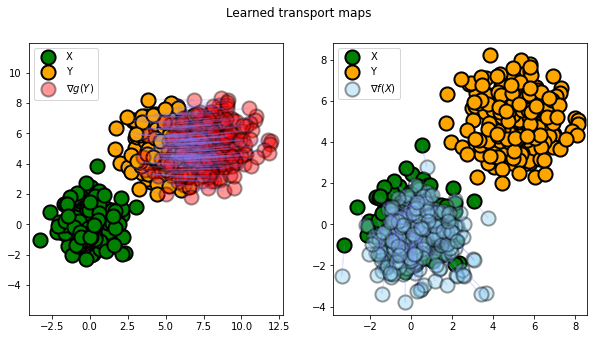

||mean(T(Y) - mean(X)||: 0.5443310737609863
iteration: 500 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 22.376585006713867


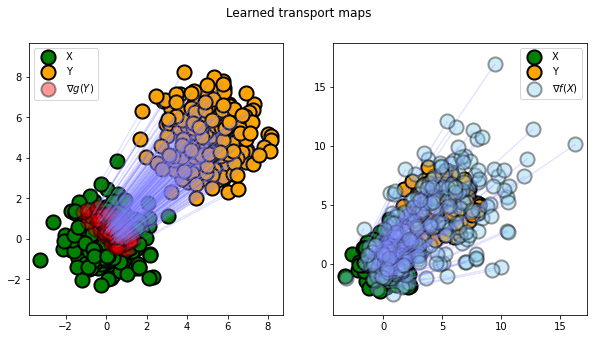

||mean(T(Y) - mean(X)||: 0.27986520528793335
iteration: 1000 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 23.948530197143555


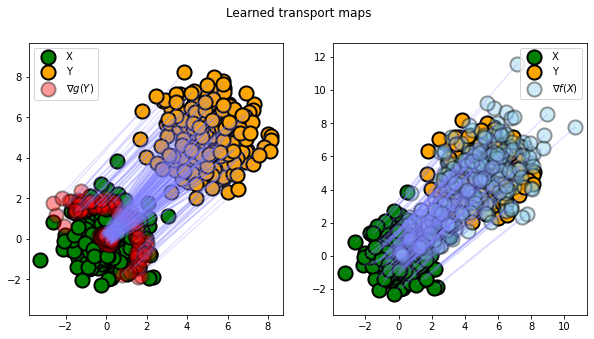

||mean(T(Y) - mean(X)||: 0.09351272135972977
iteration: 1500 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 25.339101791381836


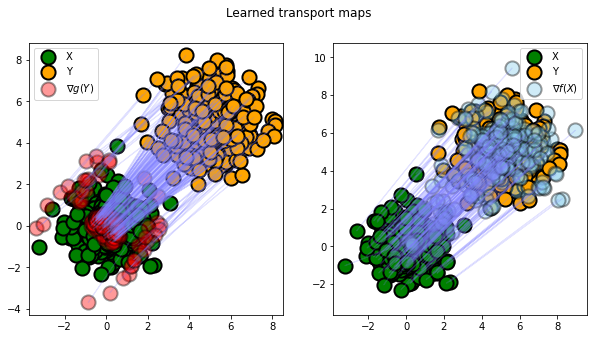

||mean(T(Y) - mean(X)||: 0.06378761678934097
iteration: 2000 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 25.10470962524414


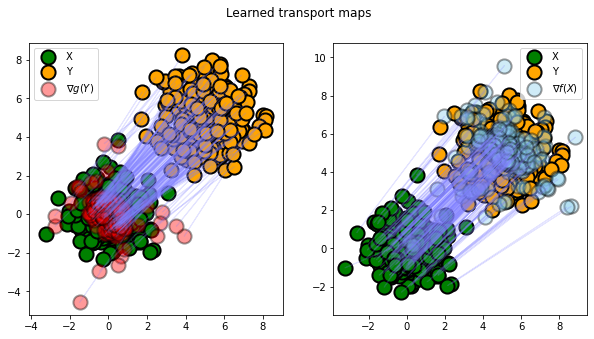

||mean(T(Y) - mean(X)||: 0.07077556103467941
iteration: 2500 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 25.990854263305664


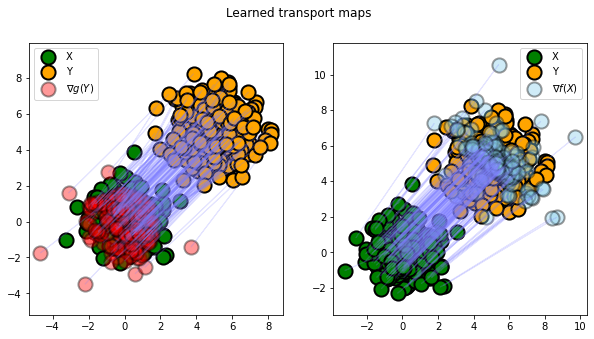

||mean(T(Y) - mean(X)||: 0.09142610430717468
iteration: 3000 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 25.43759536743164


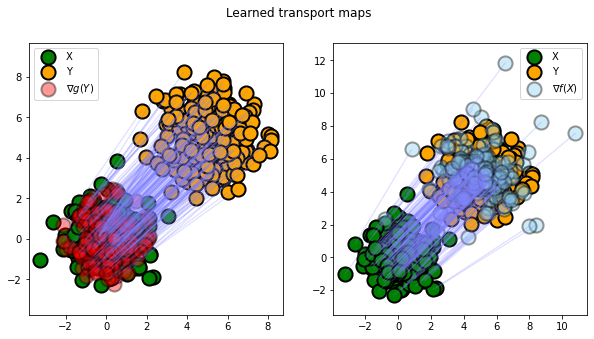

||mean(T(Y) - mean(X)||: 0.0812816321849823
iteration: 3500 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 26.346988677978516


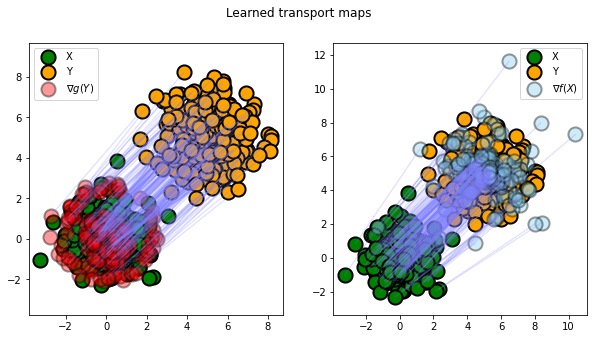

||mean(T(Y) - mean(X)||: 0.0323437862098217
iteration: 4000 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 24.285058975219727


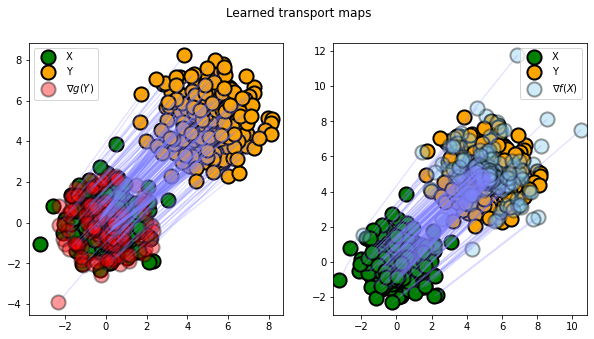

||mean(T(Y) - mean(X)||: 0.13601846992969513
iteration: 4500 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 24.527931213378906


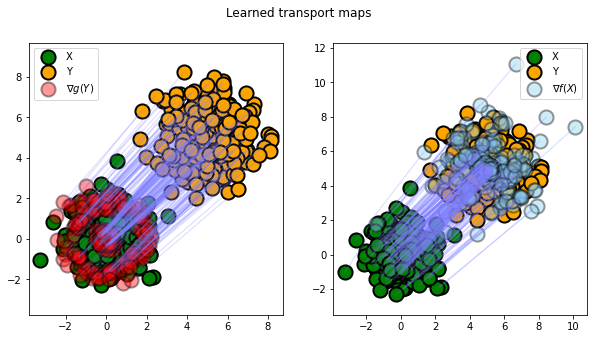

||mean(T(Y) - mean(X)||: 0.08461114764213562
iteration: 5000 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 24.93339729309082


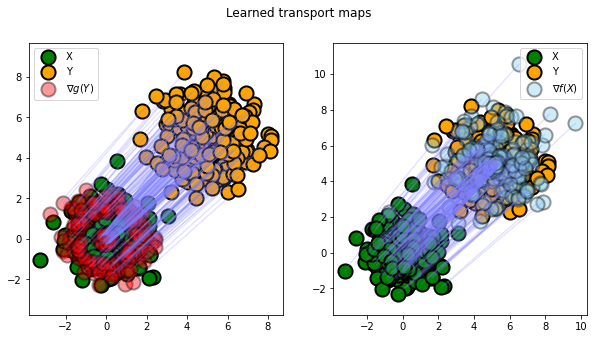

||mean(T(Y) - mean(X)||: 0.11556481570005417
iteration: 5500 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 25.569326400756836


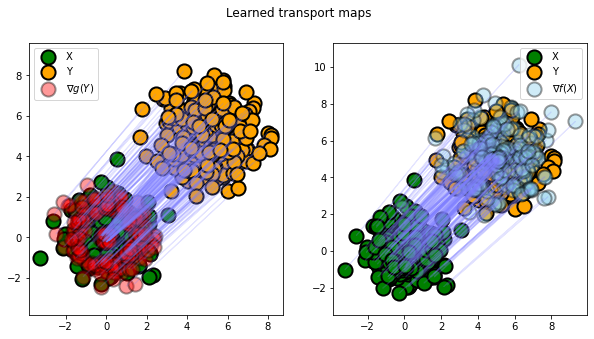

||mean(T(Y) - mean(X)||: 0.11699259281158447
iteration: 6000 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 23.95535659790039


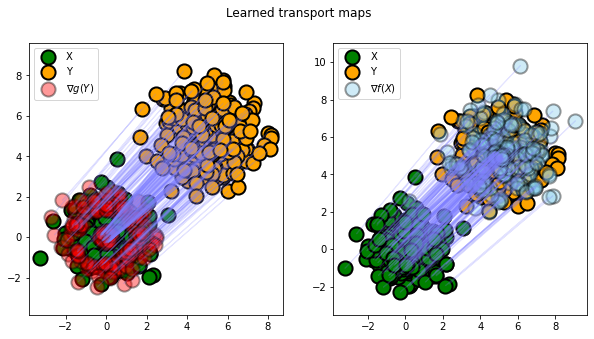

||mean(T(Y) - mean(X)||: 0.10152474045753479
iteration: 6500 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 25.389610290527344


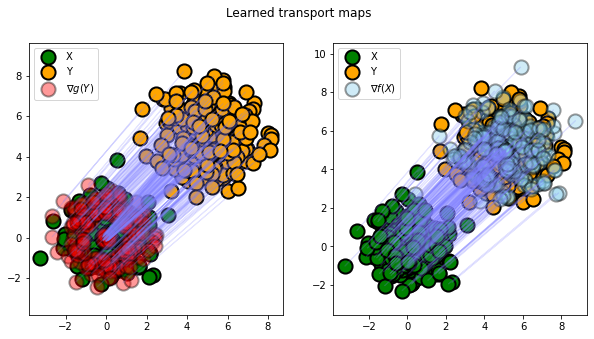

||mean(T(Y) - mean(X)||: 0.08851820975542068
iteration: 7000 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 25.815174102783203


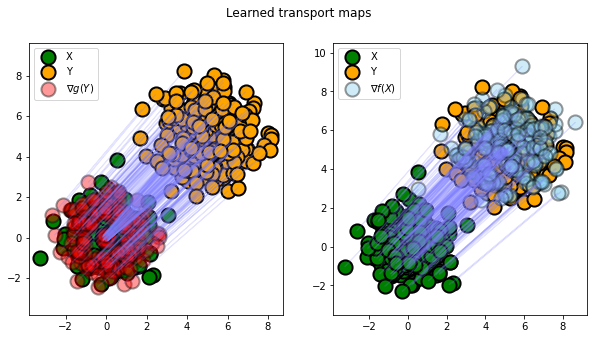

||mean(T(Y) - mean(X)||: 0.04640497639775276
iteration: 7500 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 25.08116340637207


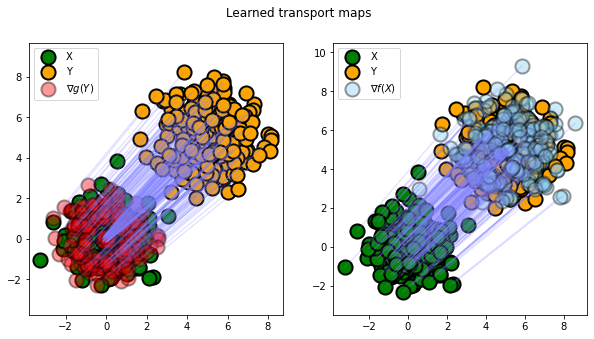

||mean(T(Y) - mean(X)||: 0.10897094756364822
iteration: 8000 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 24.956127166748047


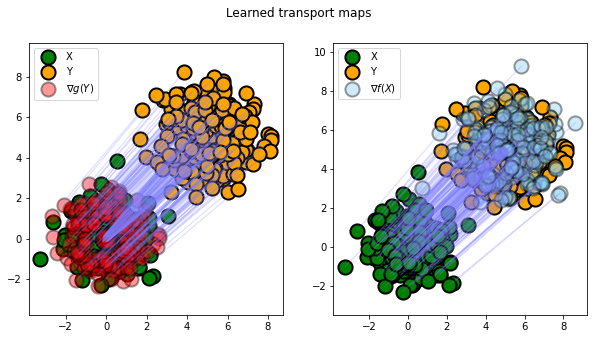

||mean(T(Y) - mean(X)||: 0.12673386931419373
iteration: 8500 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 24.67259407043457


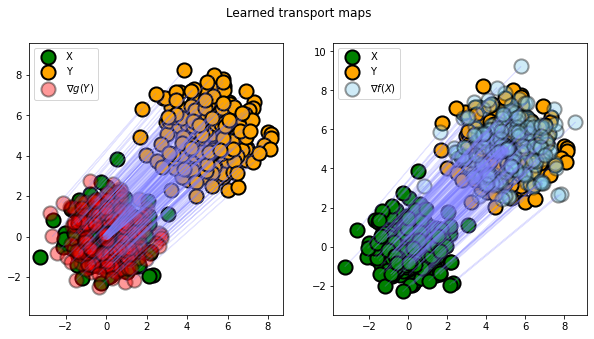

||mean(T(Y) - mean(X)||: 0.07257974147796631
iteration: 9000 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 24.51174545288086


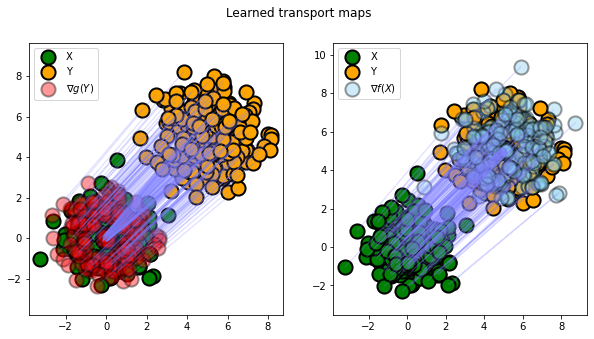

||mean(T(Y) - mean(X)||: 0.054825522005558014
iteration: 9500 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 24.252277374267578


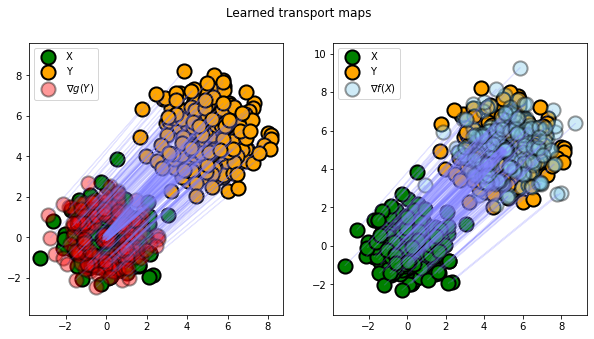

||mean(T(Y) - mean(X)||: 0.01901535503566265
iteration: 9999 | POT: 25.72974310862806 | closed form distance: 25.250000000000004| approx distance: 24.720233917236328


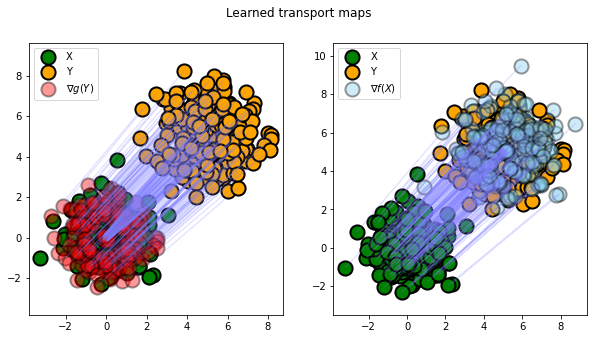

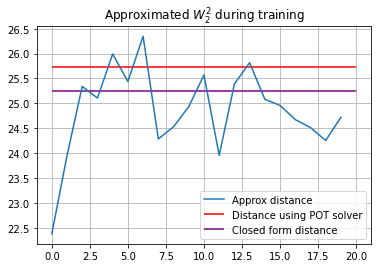

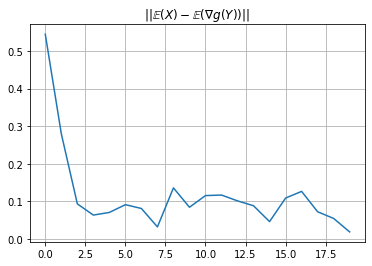

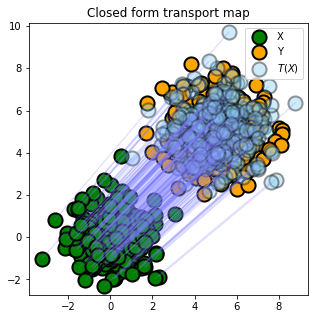

In [ ]:
torch.manual_seed(42)
np.random.seed(42)

model_2d_gaussians = IcnnOt(2, 64, 4, closed_form=True, continuous=True)
model_2d_gaussians.train(10_000, 10, 500, display_transports_2d, generate_2_gaussians, experiment_1_parameters)

### Experiment 2: Triangle of Gaussians

In [ ]:
experiment_2_parameters = {
    "train_samples": 90,
    "val_samples": 90,
    "dataset": {},
}

iteration: 0 | POT: 27.738473227366185 | approx distance: 239.8732452392578


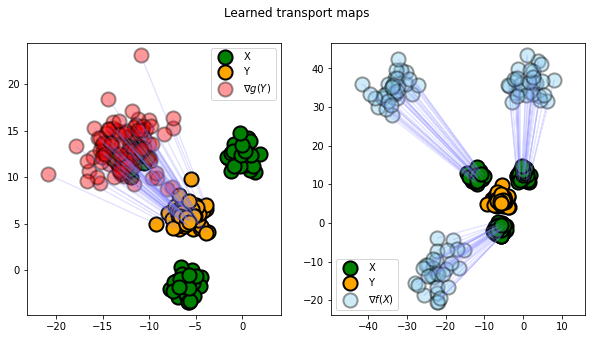

iteration: 500 | POT: 27.738473227366185 | approx distance: 16.90235137939453


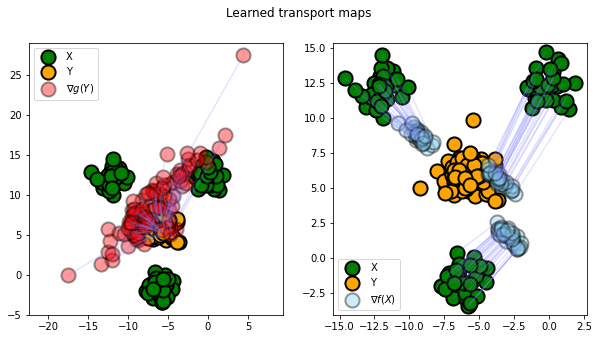

iteration: 1000 | POT: 27.738473227366185 | approx distance: 20.300865173339844


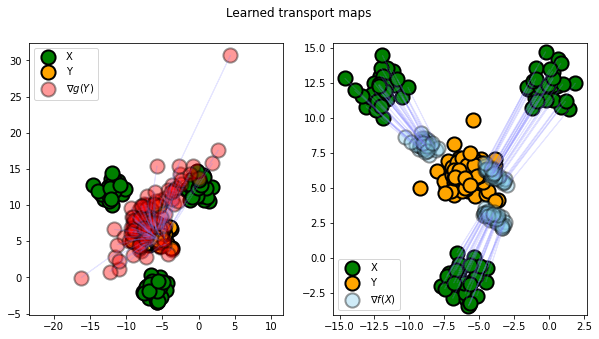

iteration: 1500 | POT: 27.738473227366185 | approx distance: 24.599899291992188


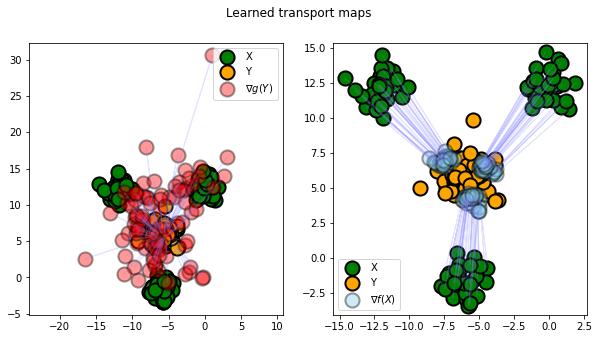

iteration: 2000 | POT: 27.738473227366185 | approx distance: 25.311294555664062


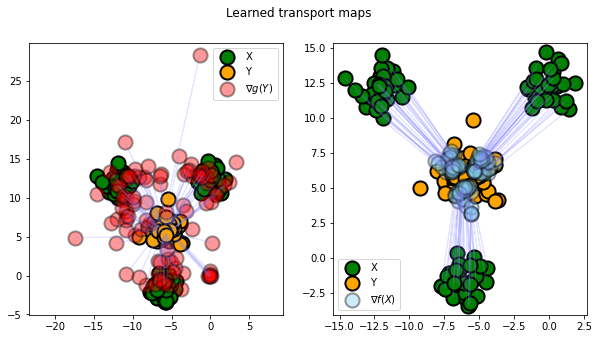

iteration: 2500 | POT: 27.738473227366185 | approx distance: 25.82262420654297


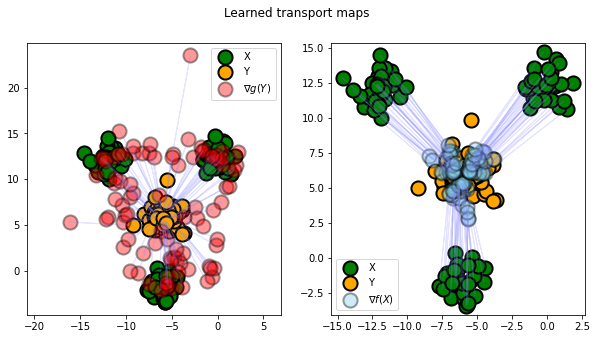

iteration: 3000 | POT: 27.738473227366185 | approx distance: 25.177757263183594


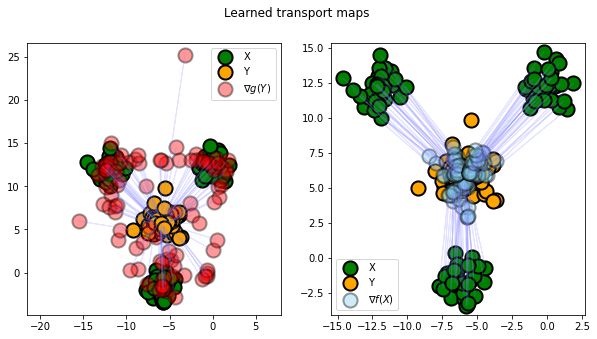

iteration: 3500 | POT: 27.738473227366185 | approx distance: 27.570655822753906


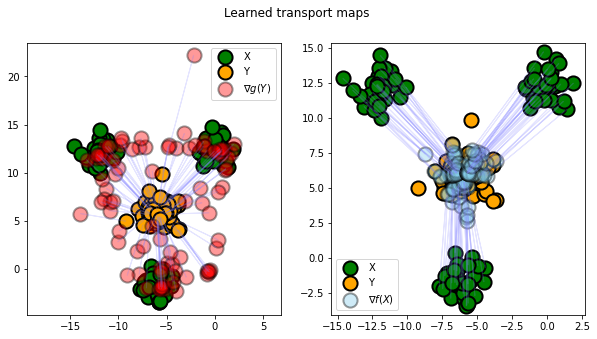

iteration: 4000 | POT: 27.738473227366185 | approx distance: 26.07860565185547


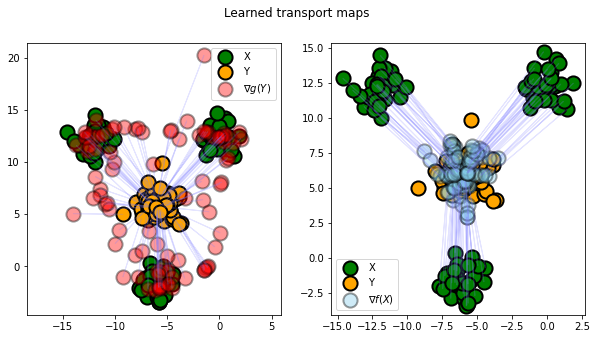

iteration: 4500 | POT: 27.738473227366185 | approx distance: 25.54181671142578


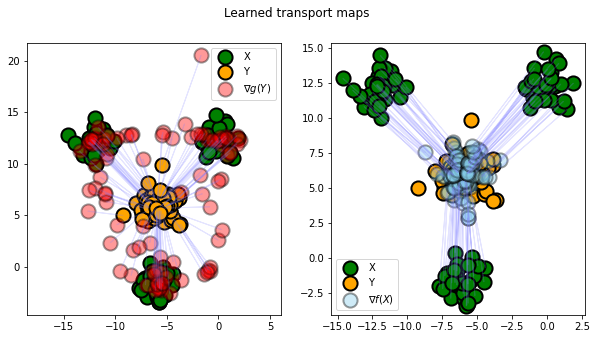

iteration: 5000 | POT: 27.738473227366185 | approx distance: 26.16802215576172


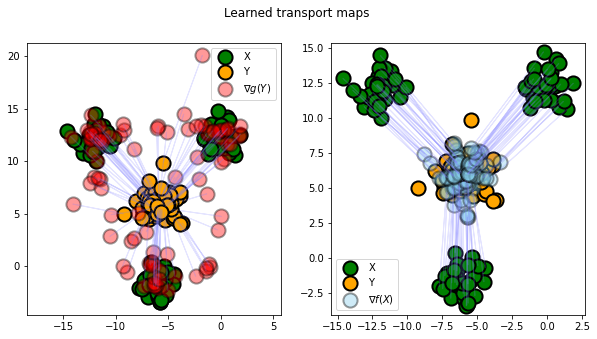

iteration: 5500 | POT: 27.738473227366185 | approx distance: 26.28887176513672


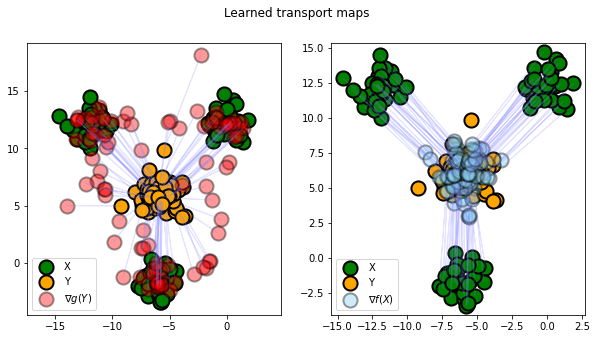

iteration: 6000 | POT: 27.738473227366185 | approx distance: 25.030426025390625


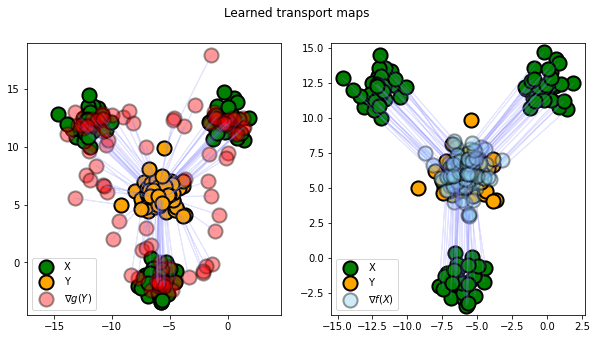

iteration: 6500 | POT: 27.738473227366185 | approx distance: 24.988174438476562


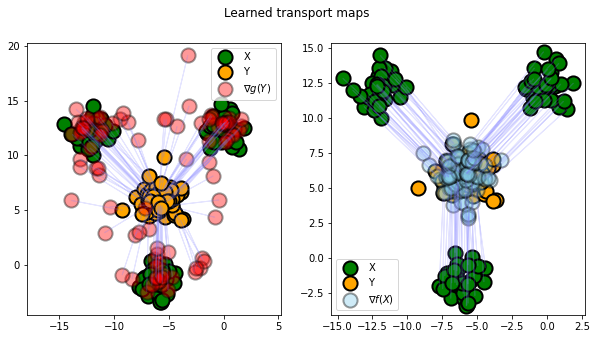

iteration: 7000 | POT: 27.738473227366185 | approx distance: 27.146209716796875


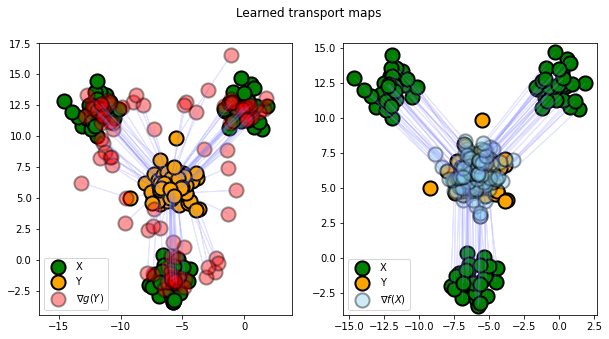

iteration: 7500 | POT: 27.738473227366185 | approx distance: 26.81952667236328


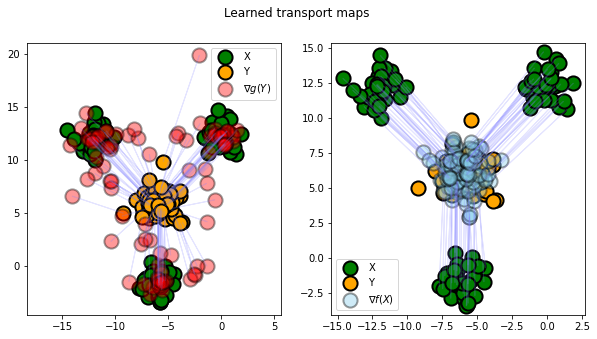

iteration: 8000 | POT: 27.738473227366185 | approx distance: 27.15790557861328


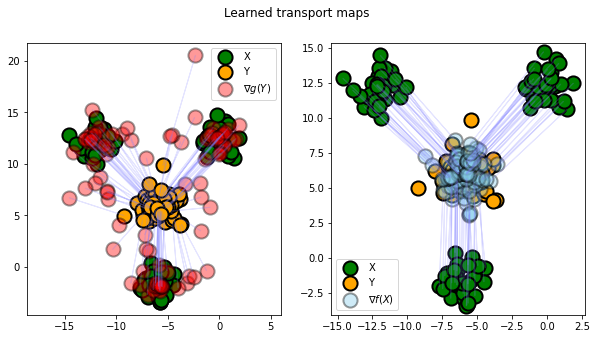

iteration: 8500 | POT: 27.738473227366185 | approx distance: 25.50853729248047


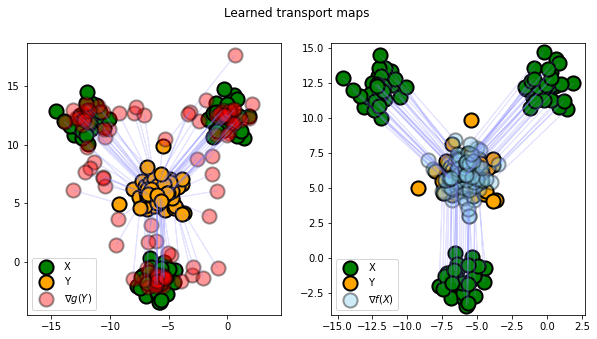

iteration: 9000 | POT: 27.738473227366185 | approx distance: 27.66053009033203


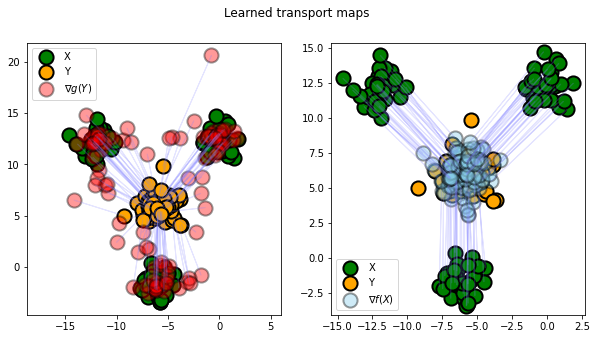

iteration: 9500 | POT: 27.738473227366185 | approx distance: 26.115554809570312


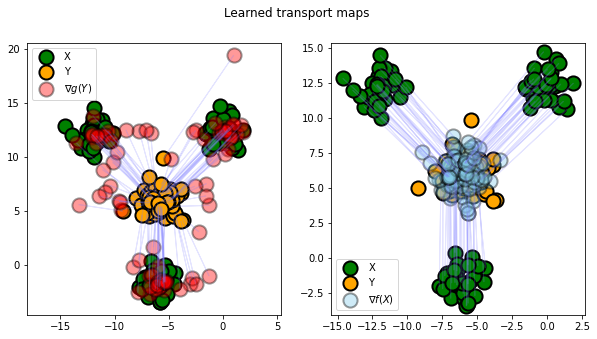

iteration: 9999 | POT: 27.738473227366185 | approx distance: 25.790664672851562


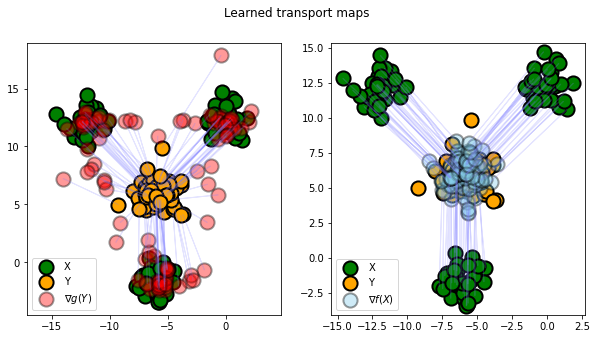

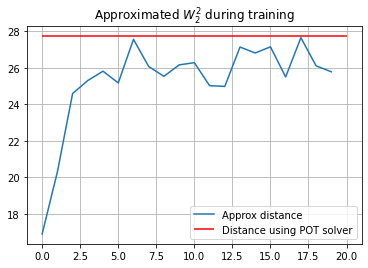

In [ ]:
torch.manual_seed(42)
np.random.seed(42)

model_triangle_gaussians_easy = IcnnOt(2, 128, 4, continuous=True)
model_triangle_gaussians_easy.train(10_000, 50, 500, display_transports_2d, generate_triangle_of_gaussians, experiment_2_parameters)

### Experiment 3: Mixture of Gaussians

In [ ]:
experiment_3_parameters = {
    "train_samples": 1024,
    "val_samples": 256,
    "dataset": {},
}

iteration: 0 | POT: 7.357987360221251 | approx distance: 0.5147686004638672


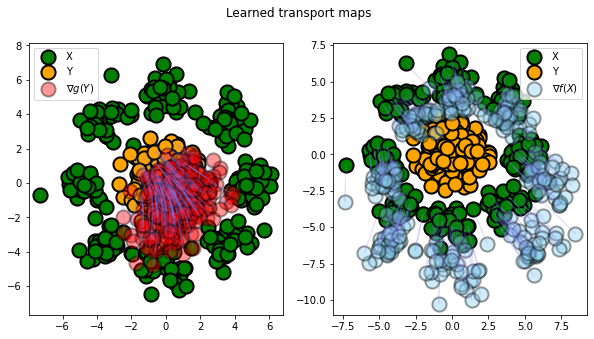

iteration: 500 | POT: 7.357987360221251 | approx distance: 6.716479301452637


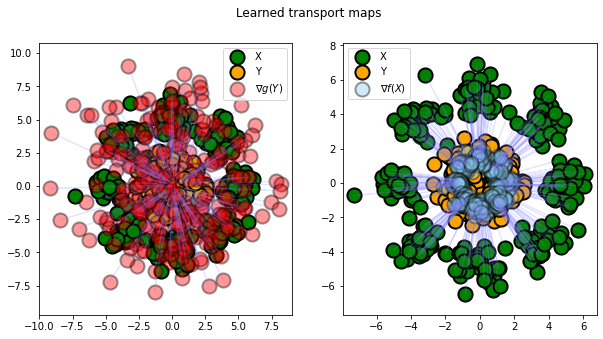

iteration: 1000 | POT: 7.357987360221251 | approx distance: 6.819973945617676


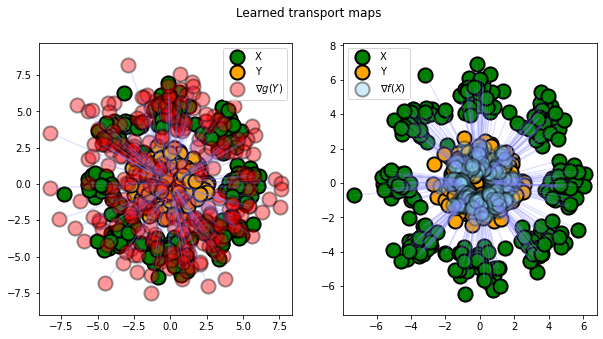

iteration: 1500 | POT: 7.357987360221251 | approx distance: 7.148518085479736


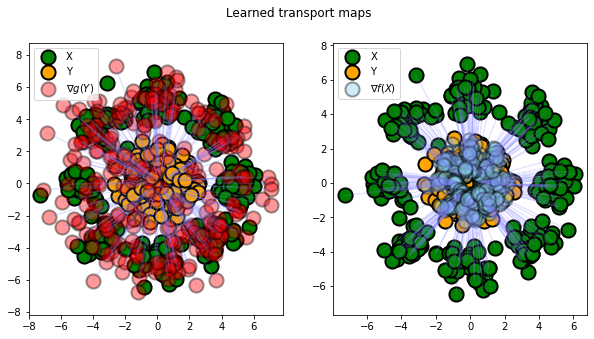

iteration: 2000 | POT: 7.357987360221251 | approx distance: 7.017158508300781


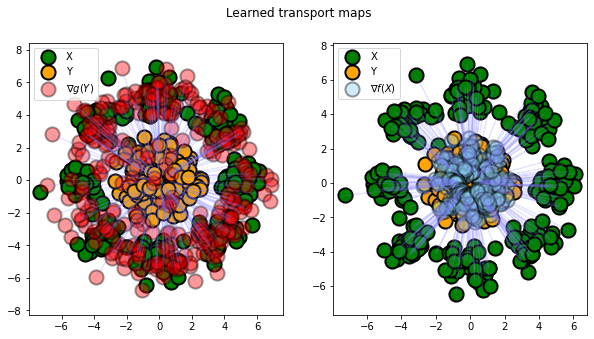

iteration: 2500 | POT: 7.357987360221251 | approx distance: 7.136579990386963


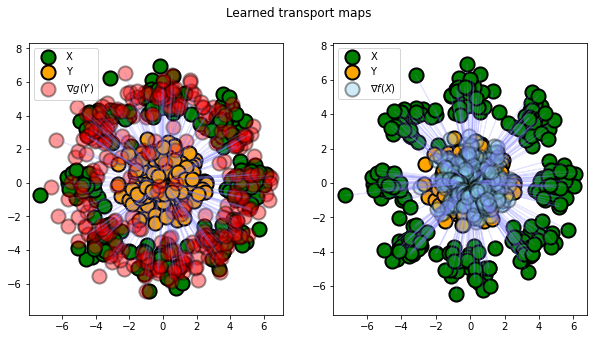

iteration: 3000 | POT: 7.357987360221251 | approx distance: 7.363478660583496


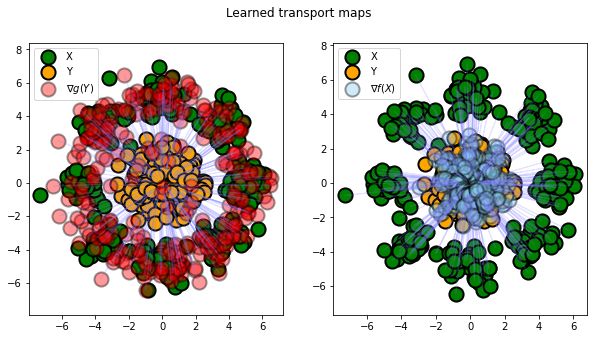

iteration: 3500 | POT: 7.357987360221251 | approx distance: 7.382856845855713


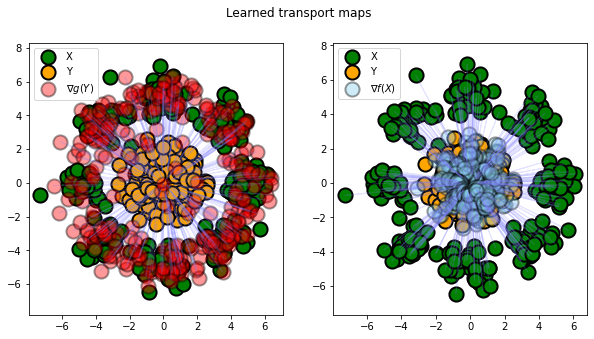

iteration: 4000 | POT: 7.357987360221251 | approx distance: 7.278008937835693


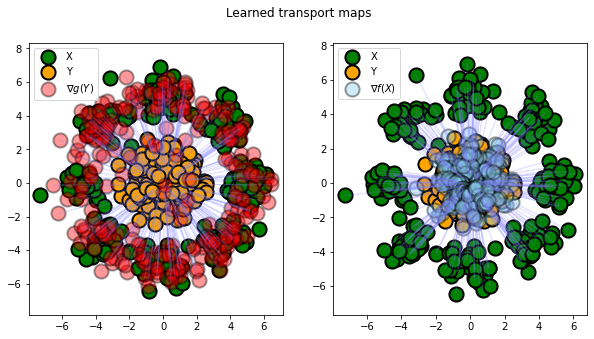

iteration: 4500 | POT: 7.357987360221251 | approx distance: 7.386318683624268


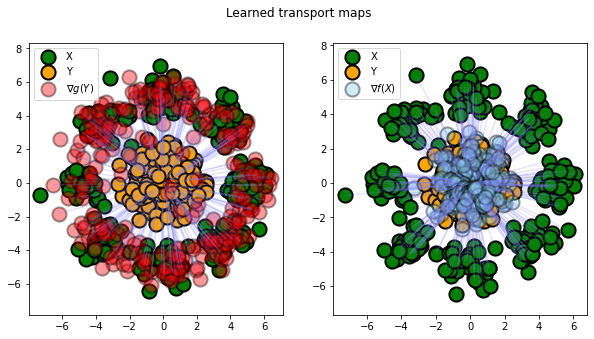

iteration: 5000 | POT: 7.357987360221251 | approx distance: 7.231278419494629


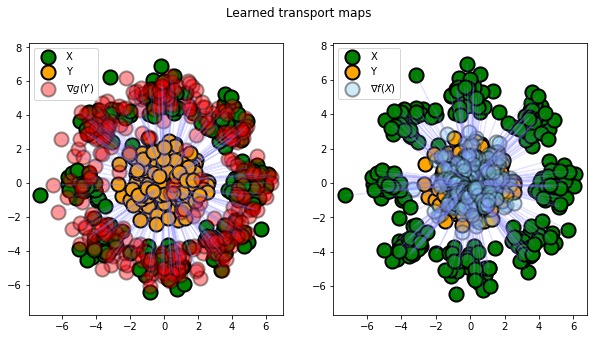

iteration: 5500 | POT: 7.357987360221251 | approx distance: 7.166561603546143


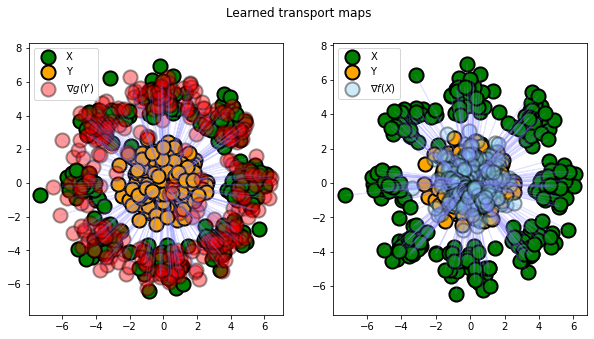

iteration: 6000 | POT: 7.357987360221251 | approx distance: 7.299135684967041


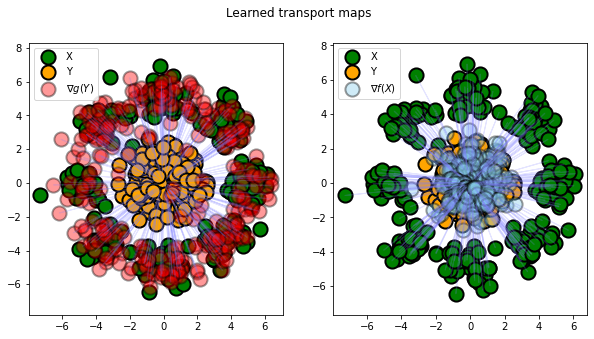

iteration: 6500 | POT: 7.357987360221251 | approx distance: 7.444581508636475


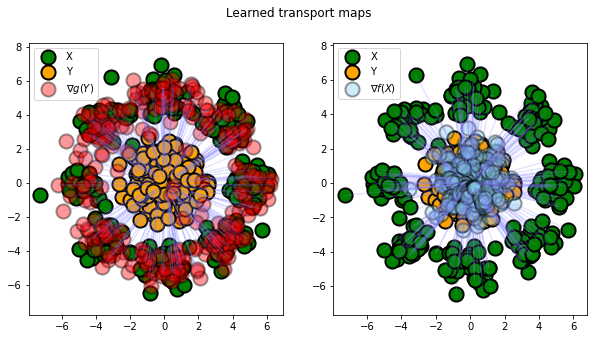

iteration: 7000 | POT: 7.357987360221251 | approx distance: 7.3748579025268555


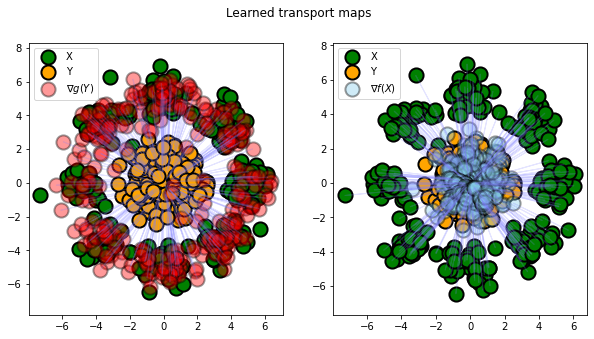

iteration: 7500 | POT: 7.357987360221251 | approx distance: 7.118895530700684


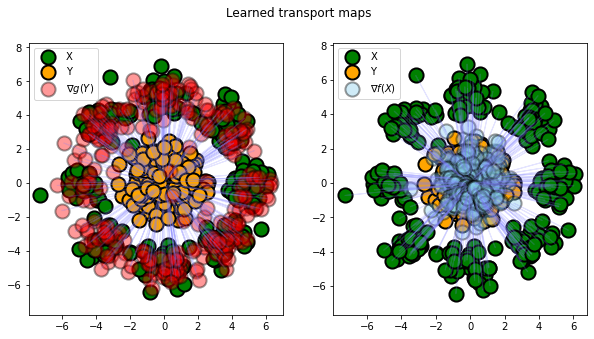

iteration: 8000 | POT: 7.357987360221251 | approx distance: 7.1621785163879395


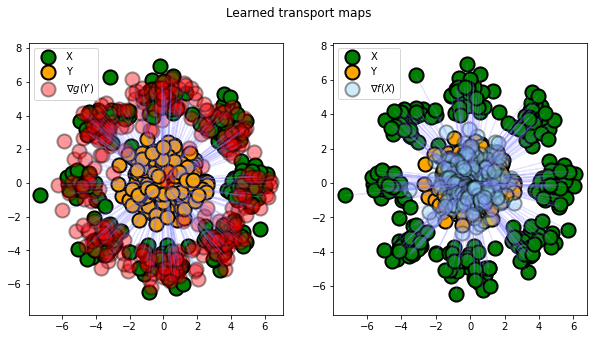

iteration: 8500 | POT: 7.357987360221251 | approx distance: 7.251082420349121


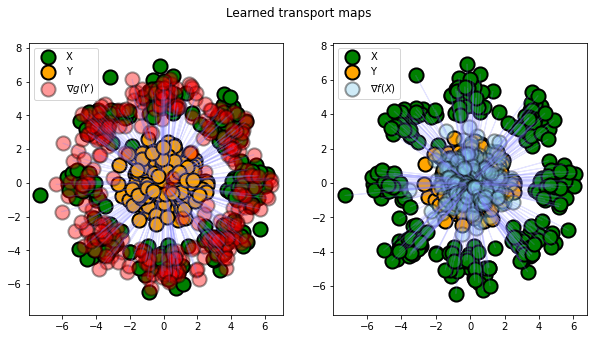

iteration: 9000 | POT: 7.357987360221251 | approx distance: 7.397665023803711


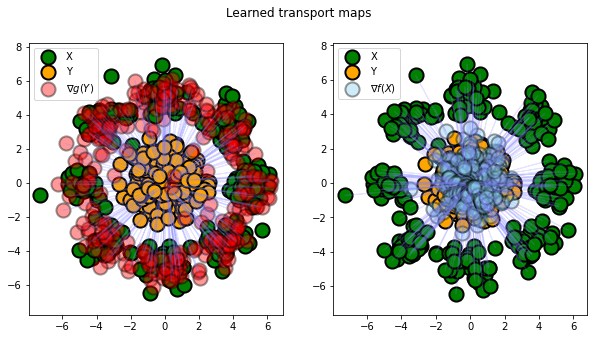

iteration: 9500 | POT: 7.357987360221251 | approx distance: 7.145806312561035


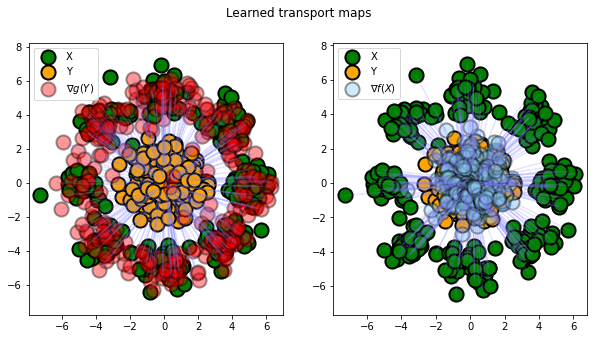

iteration: 9999 | POT: 7.357987360221251 | approx distance: 7.27811861038208


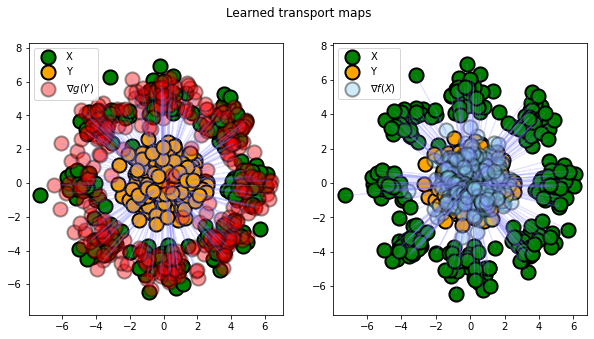

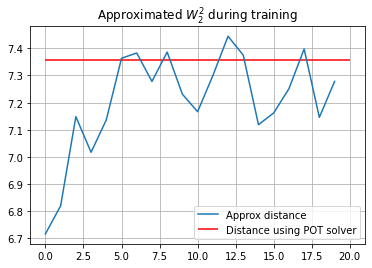

In [ ]:
torch.manual_seed(42)
np.random.seed(42)

model_mixture = IcnnOt(2, 64, 4, continuous=True)
model_mixture.train(10_000, 10, 500, display_transports_2d, generate_8_gaussians, experiment_3_parameters)

### Experiment 4: Gaussian translation in high dim

In [ ]:
experiment_4_parameters = {
    "train_samples": 64,
    "val_samples": 128,
    "dataset": {
        "mean_X": np.ones(300)*3,
        "var_X": 1,
        "mean_Y": np.ones(300)*-1,
        "var_Y": 1
    },
}

||mean(T(Y) - mean(X)||: 76.96979522705078
iteration: 0 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 526.438720703125


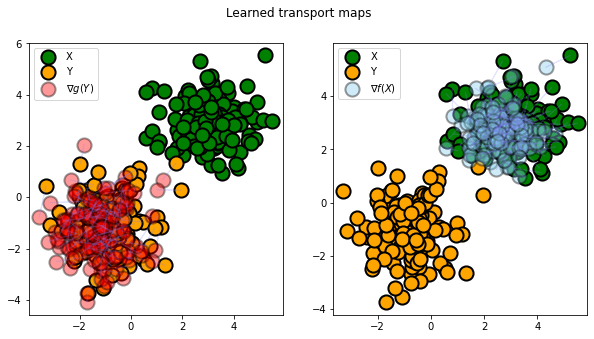

||mean(T(Y) - mean(X)||: 46.20872497558594
iteration: 500 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 1922.1080322265625


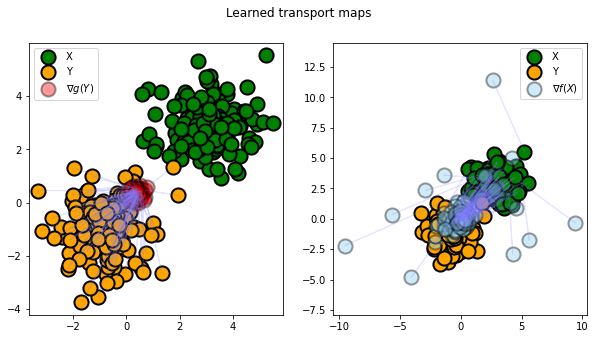

||mean(T(Y) - mean(X)||: 34.50186538696289
iteration: 1000 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2305.288818359375


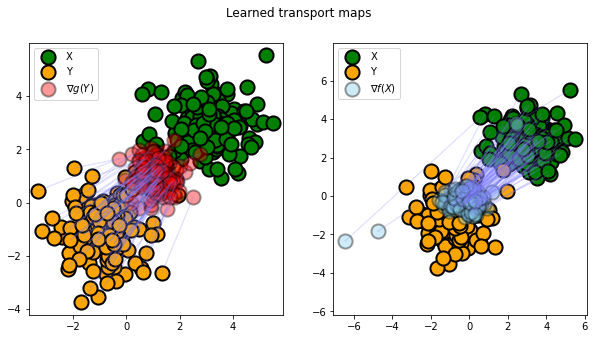

||mean(T(Y) - mean(X)||: 11.138786315917969
iteration: 1500 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2418.784912109375


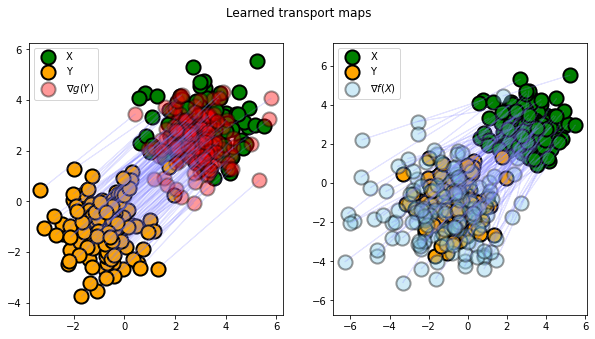

||mean(T(Y) - mean(X)||: 4.97038459777832
iteration: 2000 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2388.41943359375


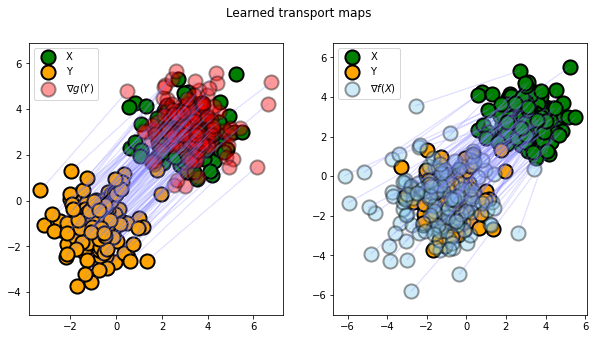

||mean(T(Y) - mean(X)||: 5.166814804077148
iteration: 2500 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2423.89453125


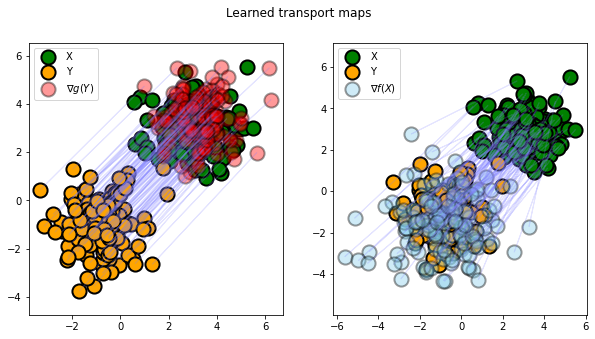

||mean(T(Y) - mean(X)||: 12.092493057250977
iteration: 3000 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2445.203125


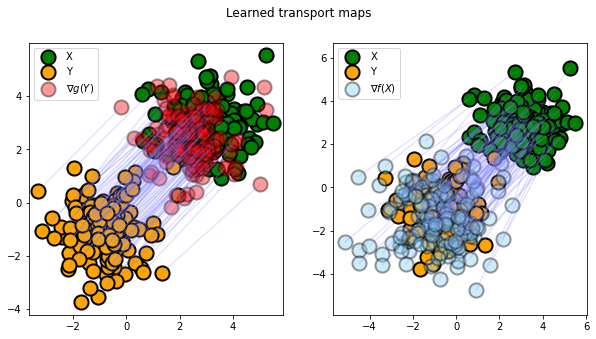

||mean(T(Y) - mean(X)||: 16.001934051513672
iteration: 3500 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2426.25634765625


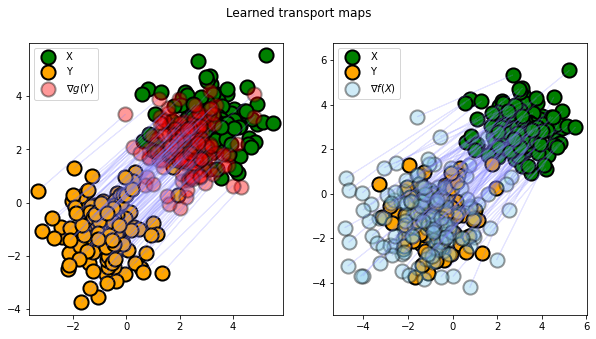

||mean(T(Y) - mean(X)||: 4.502452373504639
iteration: 4000 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2374.296875


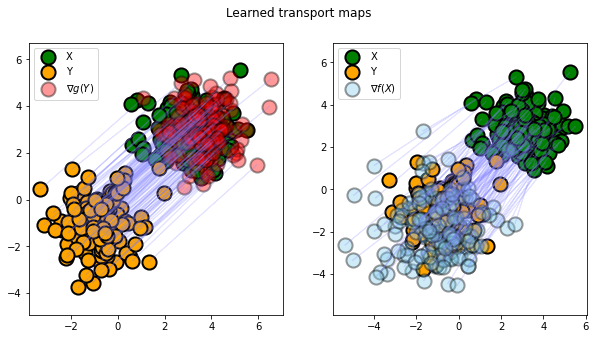

||mean(T(Y) - mean(X)||: 8.605172157287598
iteration: 4500 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2447.4736328125


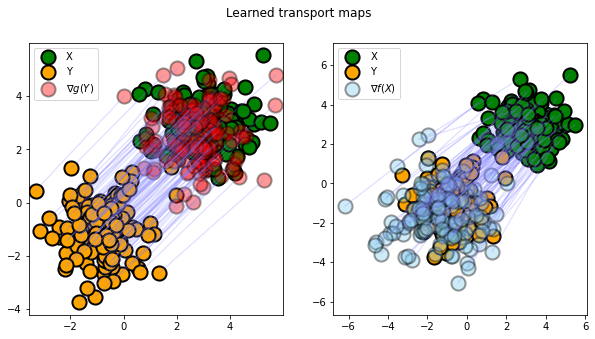

||mean(T(Y) - mean(X)||: 6.7699127197265625
iteration: 5000 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2447.732421875


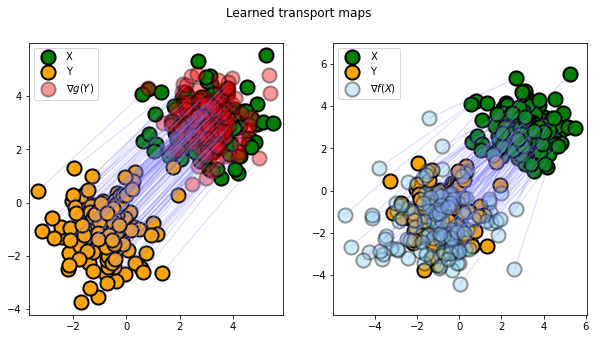

||mean(T(Y) - mean(X)||: 5.087306976318359
iteration: 5500 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2364.760986328125


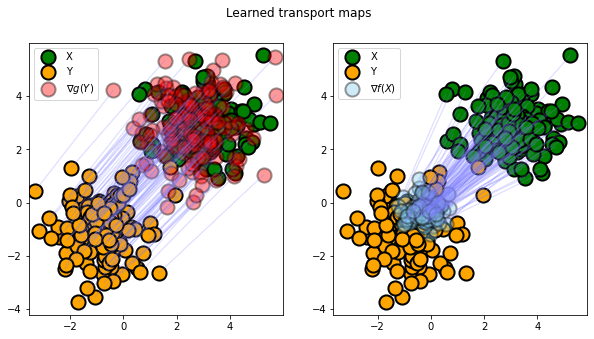

||mean(T(Y) - mean(X)||: 4.678427219390869
iteration: 6000 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2414.0166015625


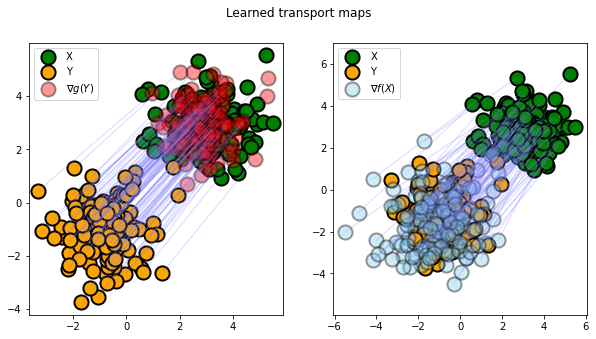

||mean(T(Y) - mean(X)||: 6.947388172149658
iteration: 6500 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2399.812744140625


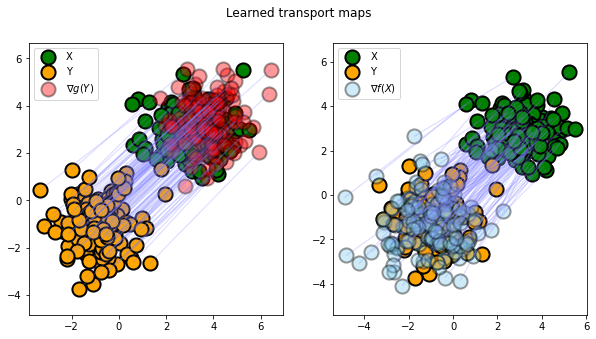

||mean(T(Y) - mean(X)||: 8.16120433807373
iteration: 7000 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2365.357421875


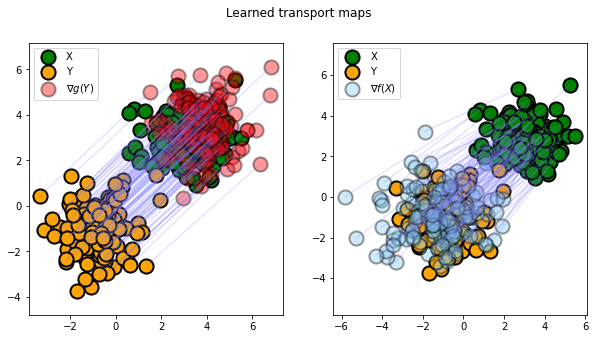

||mean(T(Y) - mean(X)||: 14.603946685791016
iteration: 7500 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2408.0595703125


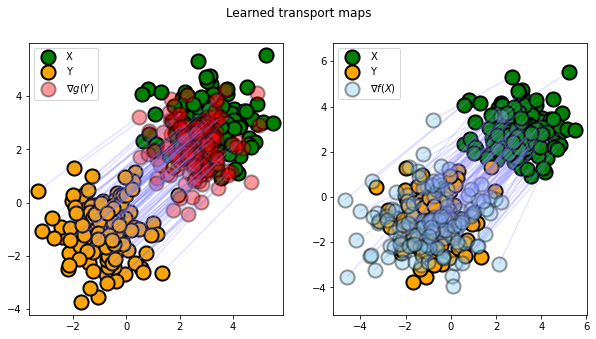

||mean(T(Y) - mean(X)||: 7.869325637817383
iteration: 8000 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2382.88916015625


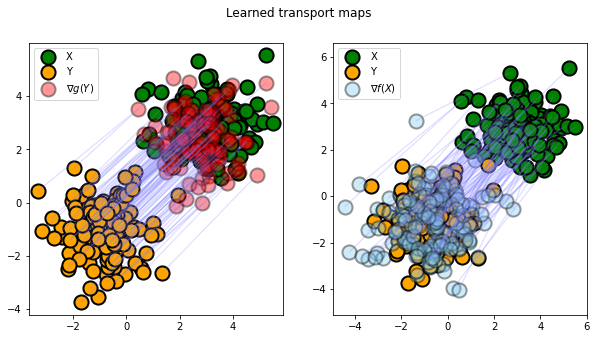

||mean(T(Y) - mean(X)||: 7.451834201812744
iteration: 8500 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2376.60400390625


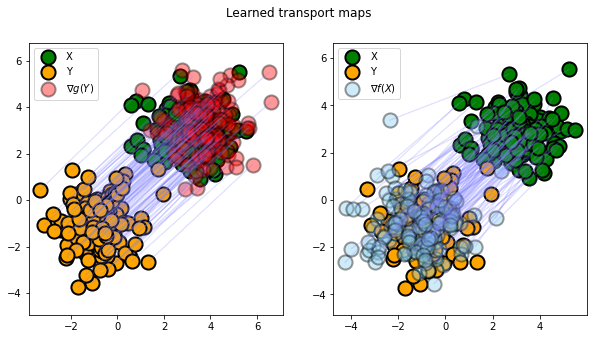

||mean(T(Y) - mean(X)||: 6.590909004211426
iteration: 9000 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2460.35302734375


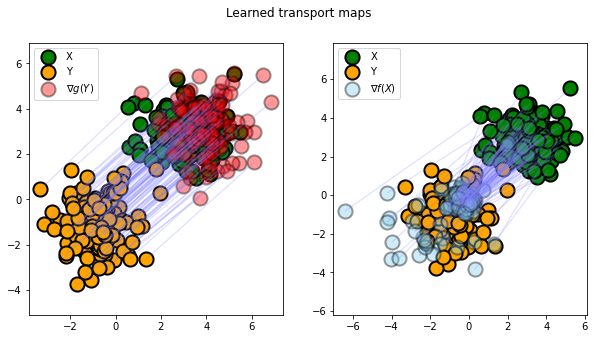

||mean(T(Y) - mean(X)||: 12.987104415893555
iteration: 9500 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2363.647705078125


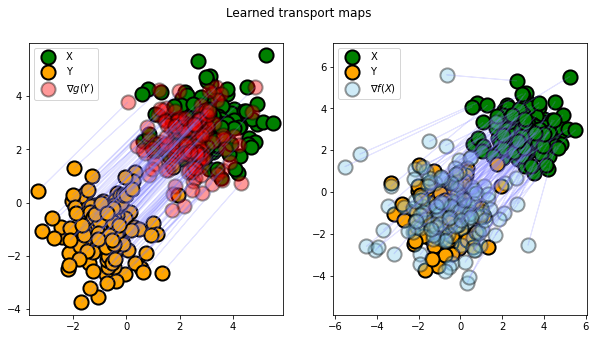

||mean(T(Y) - mean(X)||: 4.377018928527832
iteration: 9999 | POT: 2643.7117263859272 | closed form distance: 2400.0000000000005| approx distance: 2398.140625


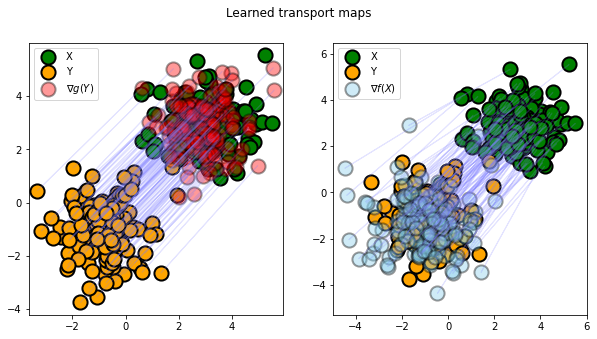

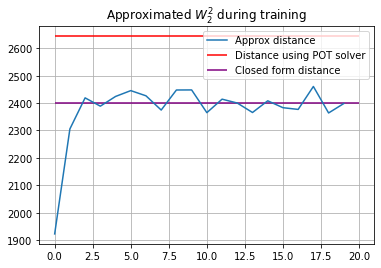

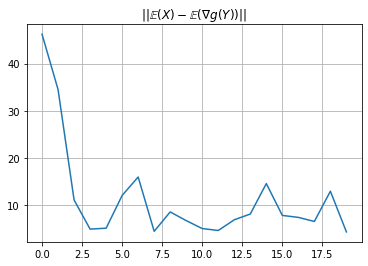

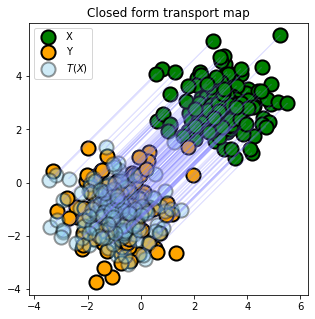

In [ ]:
torch.manual_seed(42)
np.random.seed(42)

model_high_dim = IcnnOt(300, 1024, 4, continuous=True, closed_form=True)
model_high_dim.train(10000, 10, 500, display_transports_2d,  generate_2_gaussians, experiment_4_parameters)

## Discrete - discrete

### Experiment 5: Gaussian translation in high dim

In [ ]:
experiment_5_parameters = {
    "val_samples": 10_000, # point cloud size 
    "train_samples": 64, # batch size
    "dataset": {
        "mean_X": np.ones(200)*3,
        "var_X": 1,
        "mean_Y": np.ones(200)*-1,
        "var_Y": 1
    },
}

||mean(T(Y) - mean(X)||: 63.088741302490234
iteration: 0 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 168.8807373046875


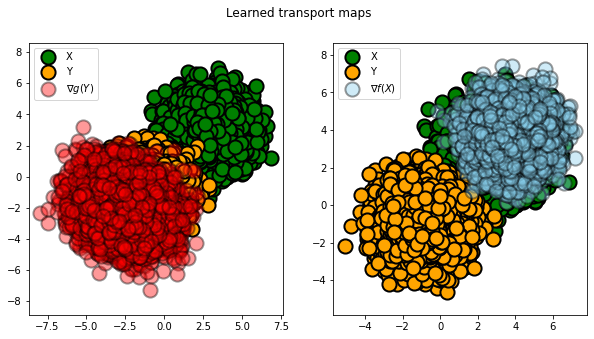

||mean(T(Y) - mean(X)||: 37.40199279785156
iteration: 500 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1305.38427734375


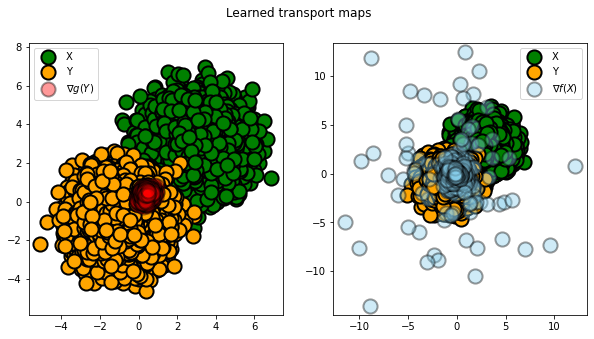

||mean(T(Y) - mean(X)||: 9.479424476623535
iteration: 1000 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1573.00927734375


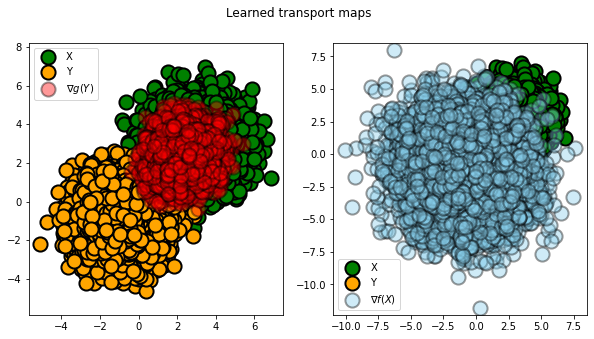

||mean(T(Y) - mean(X)||: 3.901672840118408
iteration: 1500 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1594.307373046875


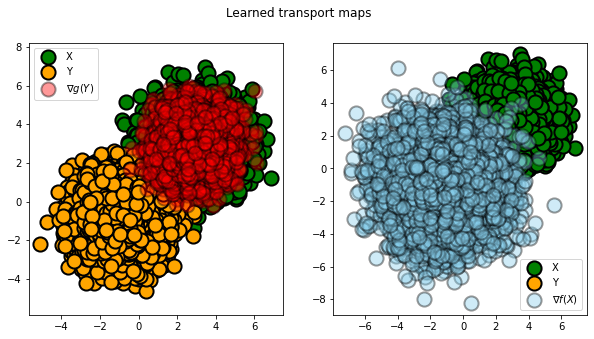

||mean(T(Y) - mean(X)||: 3.858130693435669
iteration: 2000 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1590.925048828125


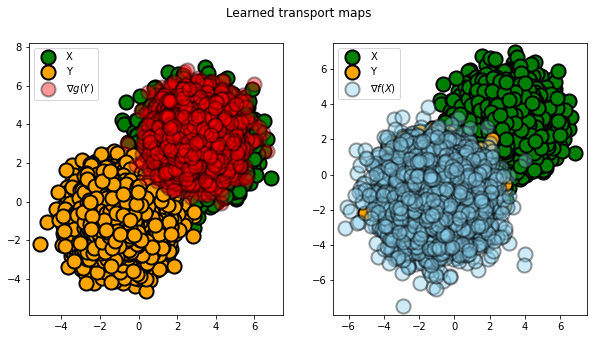

||mean(T(Y) - mean(X)||: 2.6458568572998047
iteration: 2500 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1608.57177734375


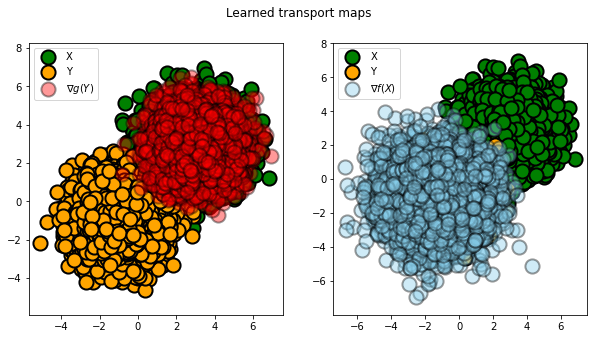

||mean(T(Y) - mean(X)||: 2.732302188873291
iteration: 3000 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1595.3740234375


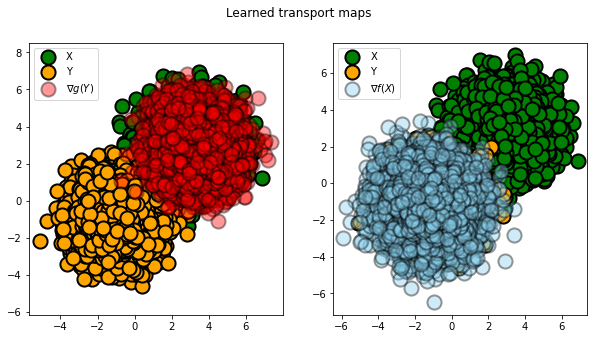

||mean(T(Y) - mean(X)||: 2.3235270977020264
iteration: 3500 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1579.1058349609375


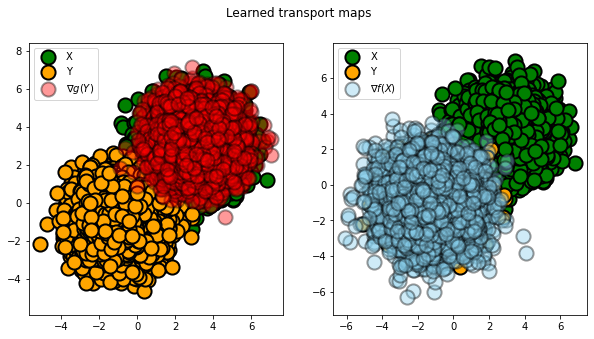

||mean(T(Y) - mean(X)||: 2.4482133388519287
iteration: 4000 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1606.2943115234375


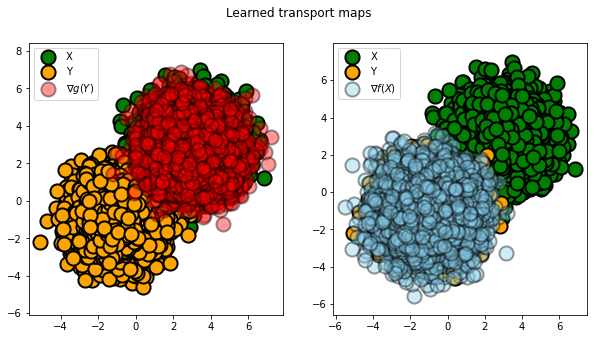

||mean(T(Y) - mean(X)||: 2.3403995037078857
iteration: 4500 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1603.732666015625


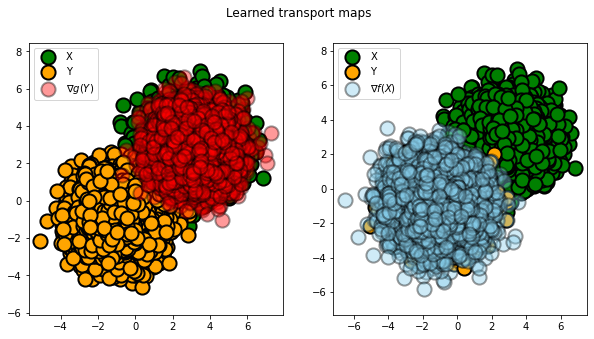

||mean(T(Y) - mean(X)||: 2.6368143558502197
iteration: 5000 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1593.404296875


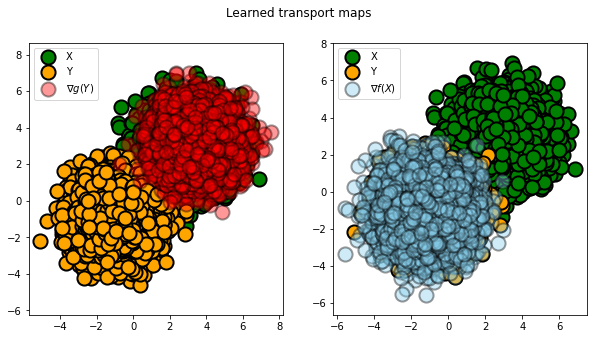

||mean(T(Y) - mean(X)||: 2.426781177520752
iteration: 5500 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1613.2415771484375


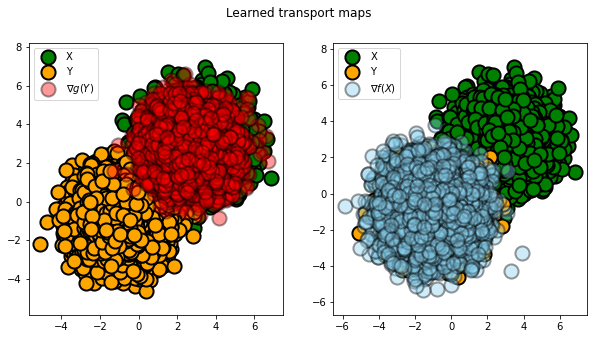

||mean(T(Y) - mean(X)||: 2.2354514598846436
iteration: 6000 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1609.440185546875


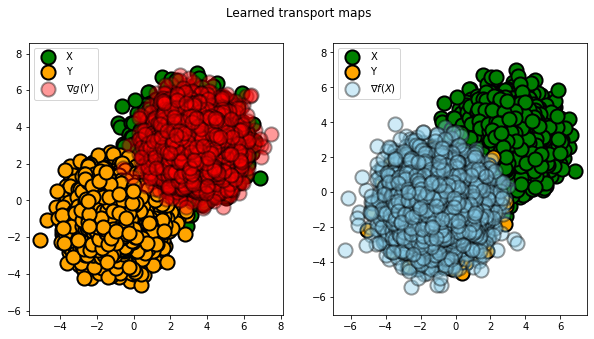

||mean(T(Y) - mean(X)||: 2.4329264163970947
iteration: 6500 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1606.2760009765625


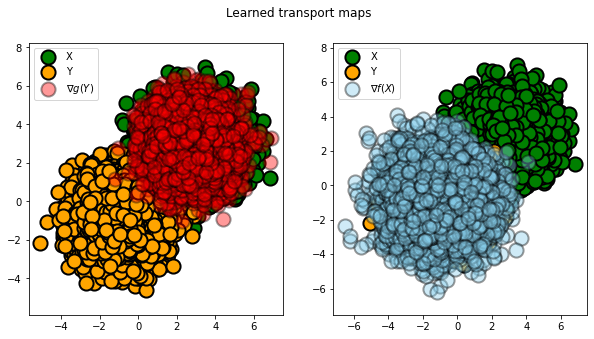

||mean(T(Y) - mean(X)||: 2.2989132404327393
iteration: 7000 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1609.468017578125


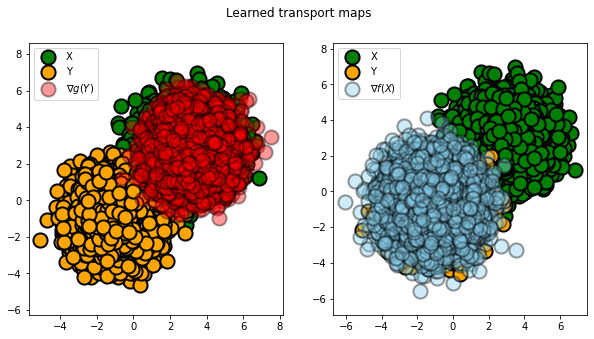

||mean(T(Y) - mean(X)||: 2.132728338241577
iteration: 7500 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1610.3302001953125


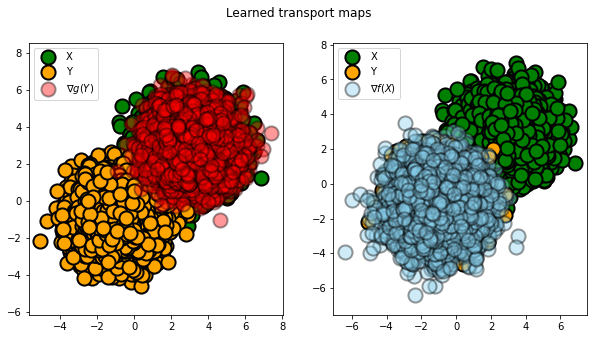

||mean(T(Y) - mean(X)||: 2.4075427055358887
iteration: 8000 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1605.557861328125


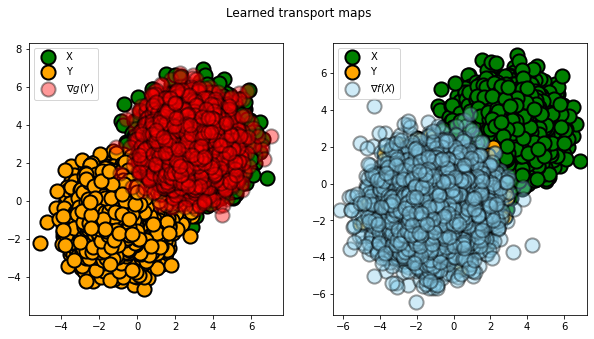

||mean(T(Y) - mean(X)||: 2.4097328186035156
iteration: 8500 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1605.6934814453125


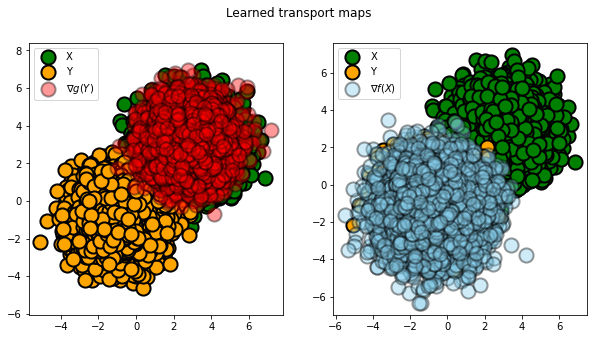

||mean(T(Y) - mean(X)||: 2.0577917098999023
iteration: 9000 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1601.59033203125


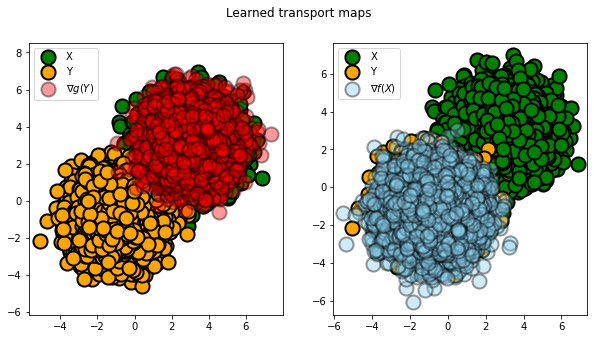

||mean(T(Y) - mean(X)||: 2.145188808441162
iteration: 9500 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1594.69775390625


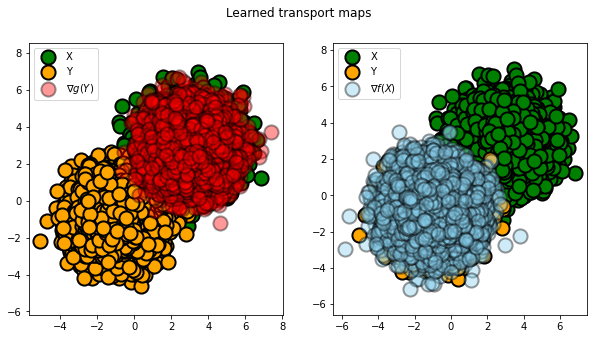

||mean(T(Y) - mean(X)||: 1.8047032356262207
iteration: 9999 | POT: 1746.9752390488798 | closed form distance: 1600.0000000000002| approx distance: 1595.8973388671875


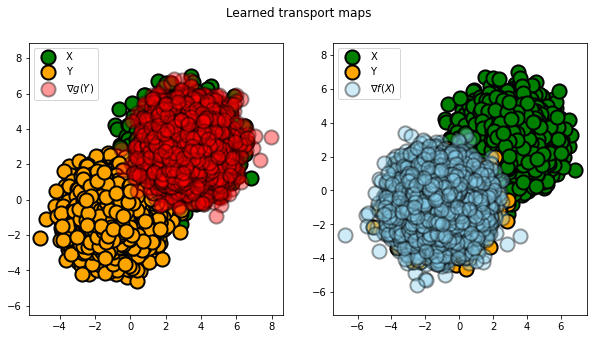

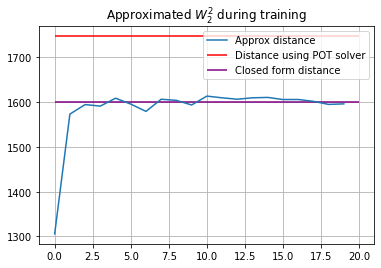

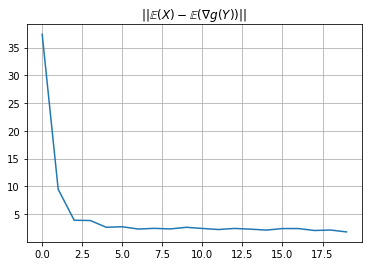

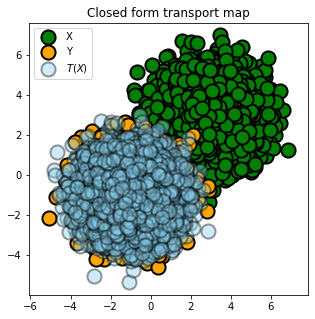

In [ ]:
torch.manual_seed(42)
np.random.seed(42)

model_high_dim = IcnnOt(200, 1024, 4, continuous=False, closed_form=True)
model_high_dim.train(10000, 10, 500, display_transports_2d,  generate_2_gaussians, experiment_5_parameters)

### Experiment 6: Triangle of Gaussians

In [ ]:
experiment_6_parameters = {
    "trian_samples": 90,
    "val_samples": 90,
    "dataset": {},
}

iteration: 0 | POT: 27.738473227366185 | approx distance: 210.22158813476562


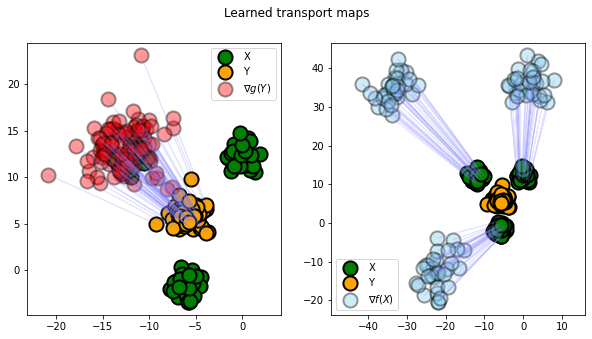

iteration: 500 | POT: 27.738473227366185 | approx distance: 18.762527465820312


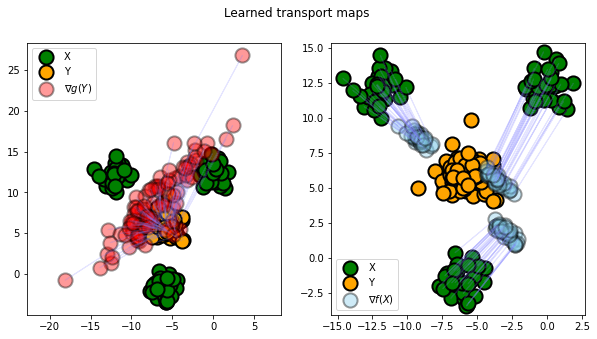

iteration: 1000 | POT: 27.738473227366185 | approx distance: 24.956130981445312


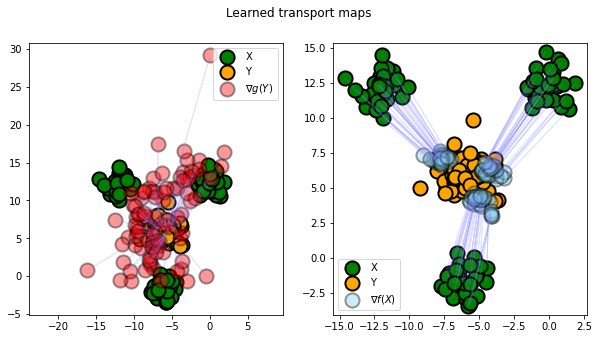

iteration: 1500 | POT: 27.738473227366185 | approx distance: 27.28528594970703


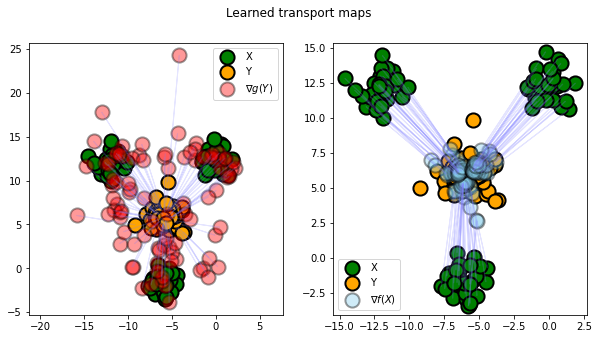

iteration: 2000 | POT: 27.738473227366185 | approx distance: 27.322250366210938


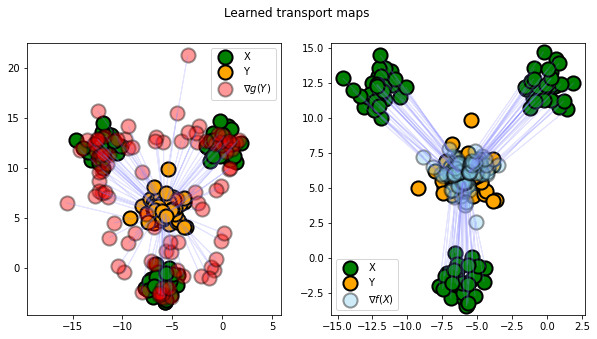

iteration: 2500 | POT: 27.738473227366185 | approx distance: 27.536178588867188


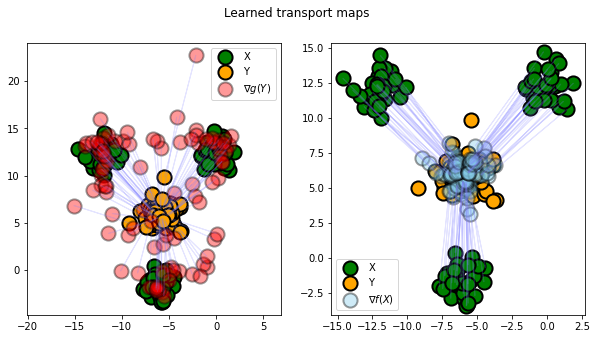

iteration: 3000 | POT: 27.738473227366185 | approx distance: 27.50574493408203


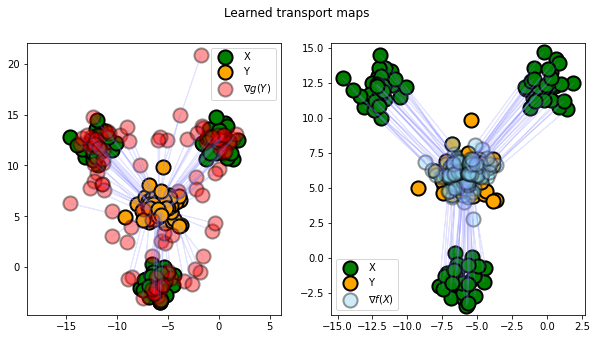

iteration: 3500 | POT: 27.738473227366185 | approx distance: 27.551666259765625


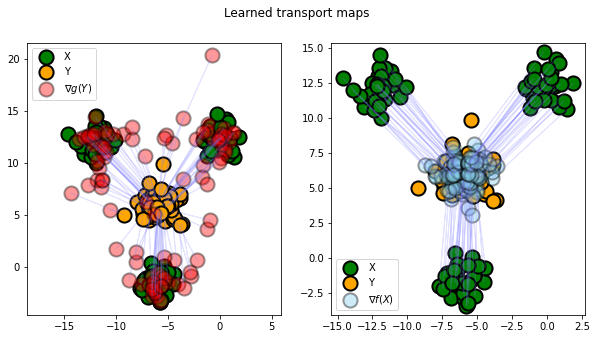

iteration: 4000 | POT: 27.738473227366185 | approx distance: 27.61211395263672


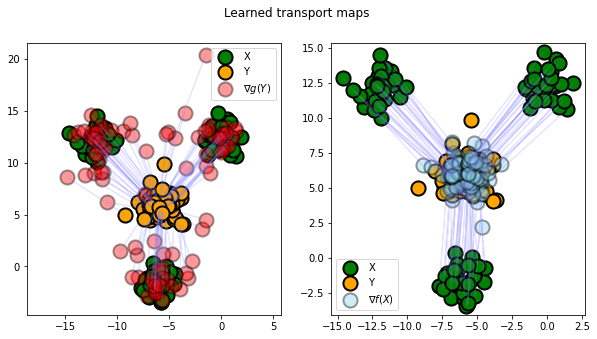

iteration: 4500 | POT: 27.738473227366185 | approx distance: 27.67737579345703


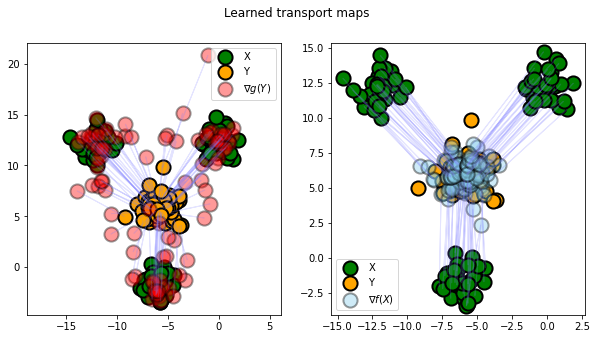

iteration: 5000 | POT: 27.738473227366185 | approx distance: 27.805023193359375


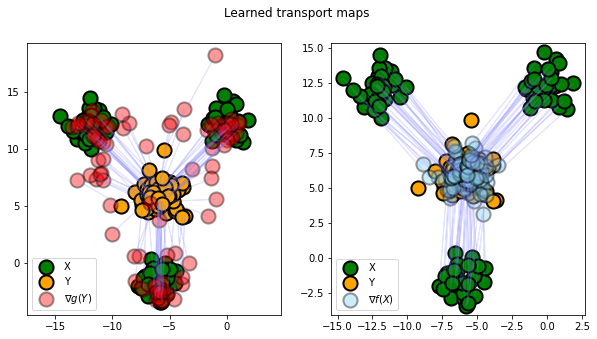

iteration: 5500 | POT: 27.738473227366185 | approx distance: 27.70610809326172


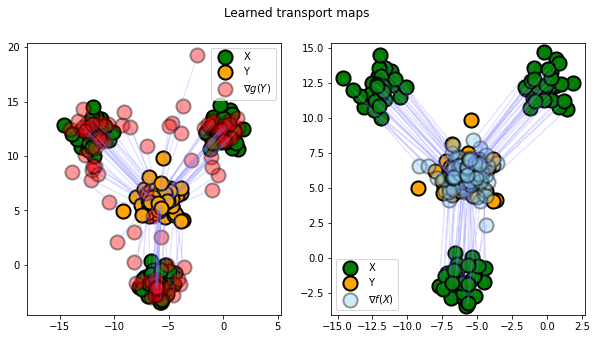

iteration: 6000 | POT: 27.738473227366185 | approx distance: 27.734893798828125


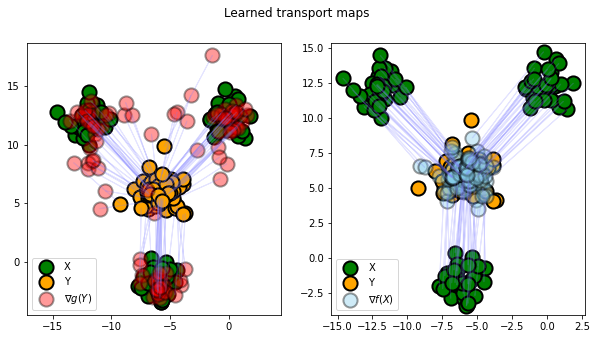

iteration: 6500 | POT: 27.738473227366185 | approx distance: 27.73712158203125


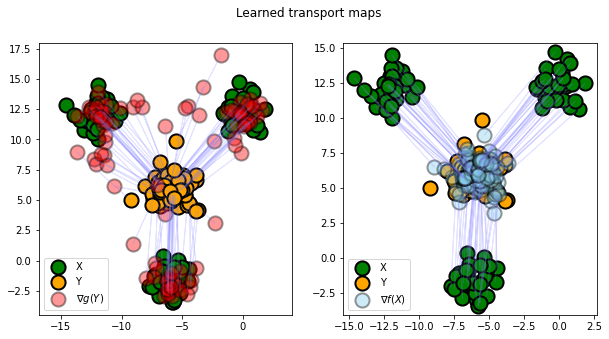

iteration: 7000 | POT: 27.738473227366185 | approx distance: 27.736312866210938


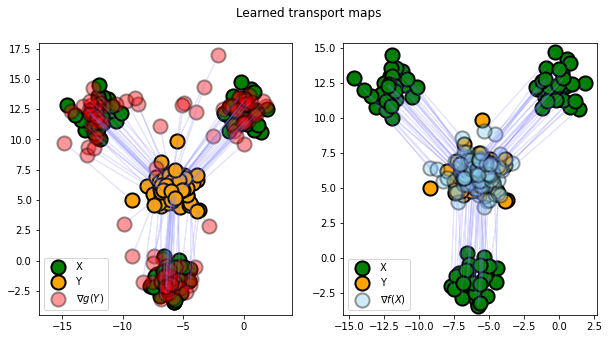

iteration: 7500 | POT: 27.738473227366185 | approx distance: 27.72362518310547


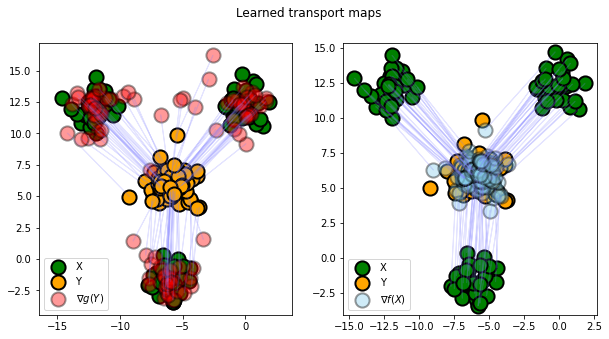

iteration: 8000 | POT: 27.738473227366185 | approx distance: 27.70655059814453


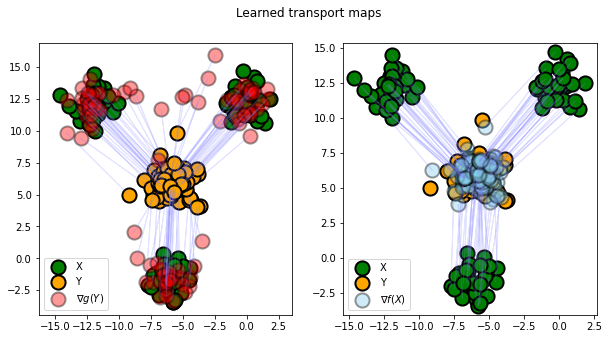

iteration: 8500 | POT: 27.738473227366185 | approx distance: 27.812973022460938


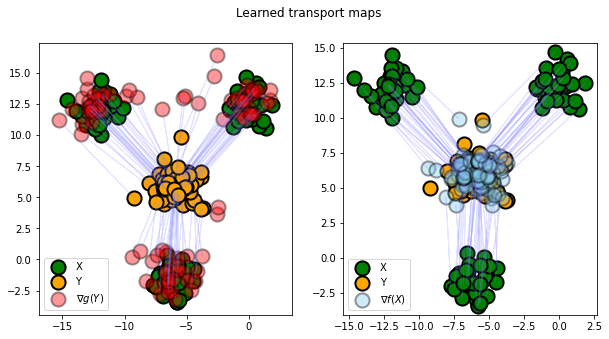

iteration: 9000 | POT: 27.738473227366185 | approx distance: 27.74462890625


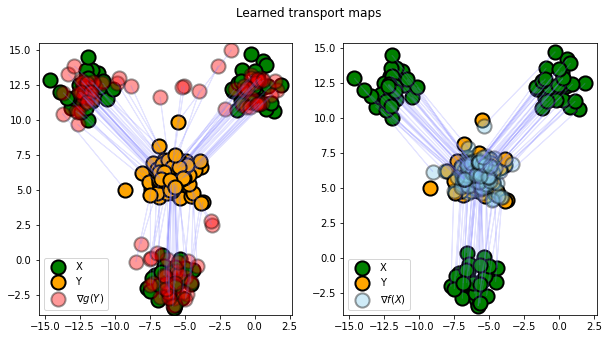

iteration: 9500 | POT: 27.738473227366185 | approx distance: 27.736770629882812


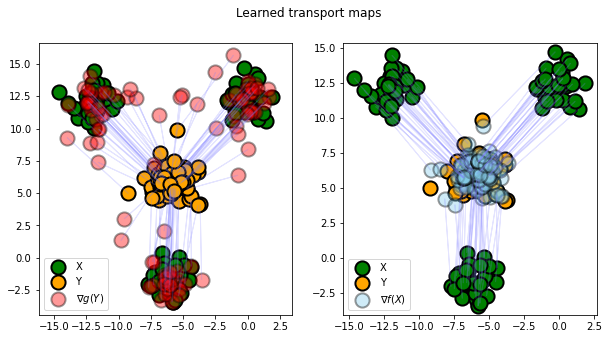

iteration: 9999 | POT: 27.738473227366185 | approx distance: 27.74848175048828


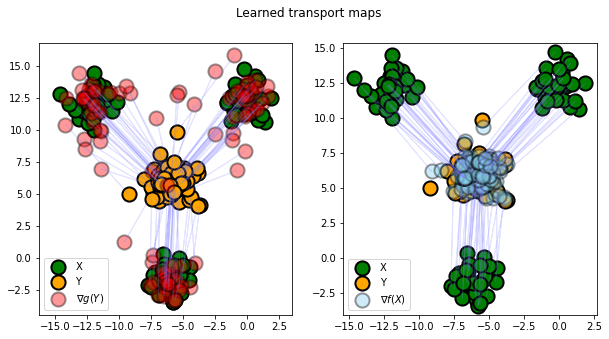

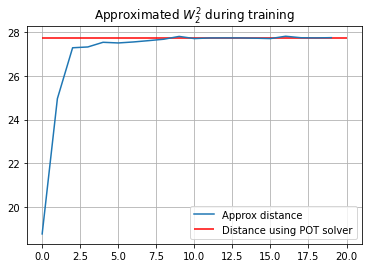

In [ ]:
torch.manual_seed(42)
np.random.seed(42)

model_triangle_gaussians_disc = IcnnOt(2, 128, 4, continuous=False)
model_triangle_gaussians_disc.train(10_000, 50, 500, display_transports_2d, generate_triangle_of_gaussians, experiment_6_parameters)